In [11]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.examples.tutorials.mnist import input_data

In [12]:
# Code by Parag Mital (github.com/pkmital/CADL)
def montage(images):
    if isinstance(images, list):
        images = np.array(images)
    img_h = images.shape[1]
    img_w = images.shape[2]
    n_plots = int(np.ceil(np.sqrt(images.shape[0])))
    m = np.ones((images.shape[1] * n_plots + n_plots + 1, images.shape[2] * n_plots + n_plots + 1)) * 0.5
    for i in range(n_plots):
        for j in range(n_plots):
            this_filter = i * n_plots + j
            if this_filter < images.shape[0]:
                this_img = images[this_filter]
                m[1 + i + i * img_h:1 + i + (i + 1) * img_h,
                  1 + j + j * img_w:1 + j + (j + 1) * img_w] = this_img
    return m

In [13]:
mnist = input_data.read_data_sets('MNIST_data')
tf.reset_default_graph()
batch_size = 64
n_noise = 64

X_in = tf.placeholder(dtype=tf.float32, shape=[None, 28, 28], name='X')
noise = tf.placeholder(dtype=tf.float32, shape=[None, n_noise])

keep_prob = tf.placeholder(dtype=tf.float32, name='keep_prob')
is_training = tf.placeholder(dtype=tf.bool, name='is_training')


Extracting MNIST_data\train-images-idx3-ubyte.gz
Extracting MNIST_data\train-labels-idx1-ubyte.gz
Extracting MNIST_data\t10k-images-idx3-ubyte.gz
Extracting MNIST_data\t10k-labels-idx1-ubyte.gz


In [14]:
def lrelu(x):
    return tf.maximum(x, tf.multiply(x, 0.2))

In [15]:
def binary_cross_entropy(x, z):
    eps = 1e-12
    return (-(x * tf.log(z + eps) + (1. - x) * tf.log(1. - z + eps)))

In [16]:
def discriminator(img_in, reuse=None, keep_prob=keep_prob):
    with tf.variable_scope("discriminator", reuse=reuse):
        x = tf.reshape(img_in, shape=[-1, 28, 28, 1])
        x = tf.layers.conv2d(x, kernel_size=5, filters=64, strides=2, padding='same', activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.layers.conv2d(x, kernel_size=5, filters=64, strides=1, padding='same', activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.layers.conv2d(x, kernel_size=5, filters=64, strides=1, padding='same', activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.flatten(x)
        x = tf.layers.dense(x, units=128, activation=lrelu)
        x = tf.layers.dense(x, units=1, activation=tf.nn.sigmoid)
        return x

In [17]:
def generator(z, keep_prob=keep_prob, is_training=is_training):
    momentum = 0.99
    with tf.variable_scope("generator", reuse=None):
        x = z
        d1 = 4
        d2 = 1
        
        x = tf.layers.dense(x, units=d1 * d1 * d2, activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)      
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)  
        x = tf.reshape(x, shape=[-1, d1, d1, d2])
        
        x = tf.image.resize_images(x, size=[7, 7])
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=64, strides=2, padding='same', activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)
        
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=64, strides=2, padding='same', activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)
        
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=64, strides=1, padding='same', activation=lrelu)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)
        
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=1, strides=1, padding='same', activation=tf.nn.sigmoid)
        return x

In [18]:
g = generator(noise, keep_prob, is_training)
d_real = discriminator(X_in)
d_fake = discriminator(g, reuse=True)

vars_g = [var for var in tf.trainable_variables() if var.name.startswith("generator")]
vars_d = [var for var in tf.trainable_variables() if var.name.startswith("discriminator")]


d_reg = tf.contrib.layers.apply_regularization(tf.contrib.layers.l2_regularizer(1e-6), vars_d)
g_reg = tf.contrib.layers.apply_regularization(tf.contrib.layers.l2_regularizer(1e-6), vars_g)

loss_d_real = binary_cross_entropy(tf.ones_like(d_real), d_real)
loss_d_fake = binary_cross_entropy(tf.zeros_like(d_fake), d_fake)
loss_g = tf.reduce_mean(binary_cross_entropy(tf.ones_like(d_fake), d_fake))
loss_d = tf.reduce_mean(0.5 * (loss_d_real + loss_d_fake))

update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
with tf.control_dependencies(update_ops):
    optimizer_d = tf.train.RMSPropOptimizer(learning_rate=0.00013).minimize(loss_d + d_reg, var_list=vars_d)
    optimizer_g = tf.train.RMSProp Optimizer(learning_rate=0.00013).minimize(loss_g + g_reg, var_list=vars_g)
    
    
sess = tf.Session()
sess.run(tf.global_variables_initializer())

SyntaxError: invalid syntax (<ipython-input-18-6ef3d429fd71>, line 20)

0 0.6893207 0.70670915 0.6988249 0.6798165


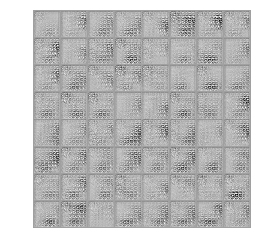

50 0.6766905 0.7355634 0.70085514 0.6525259


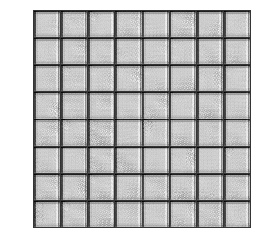

100 0.55567837 1.106595 0.70699155 0.40436518


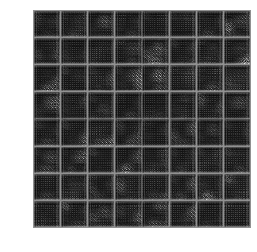

150 0.48416835 1.014761 0.5003061 0.4680305
not training discriminator


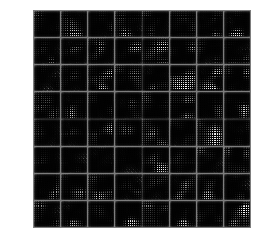

200 0.4962989 1.1667202 0.5792153 0.4133825
not training discriminator


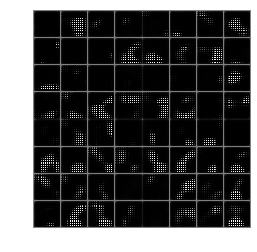

250 0.57665336 1.2052958 0.74906725 0.40423957
not training discriminator


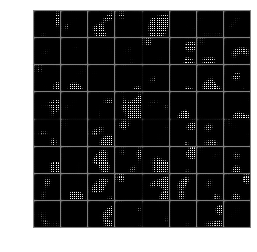

300 0.5612576 1.1539575 0.70576936 0.41674578
not training discriminator


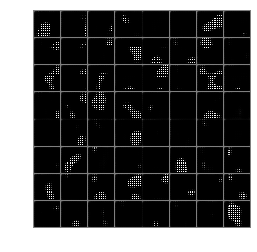

350 0.5487925 1.2501644 0.7134956 0.38408944
not training discriminator


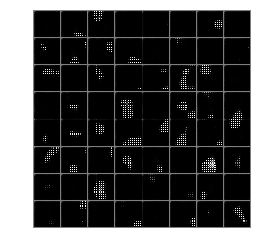

400 0.6478555 1.7859896 1.0337688 0.26194233
not training discriminator


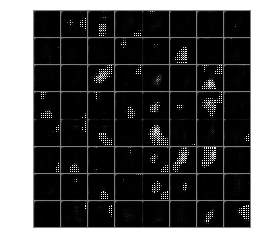

450 0.66986513 1.4856279 1.0254486 0.31428164
not training discriminator


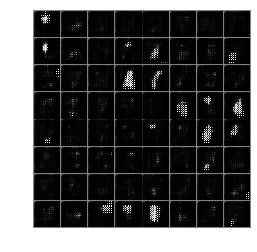

500 0.80173576 1.7920796 1.4089448 0.19452667
not training discriminator


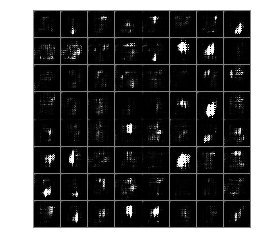

550 0.6029601 0.61087584 0.37314796 0.8327723


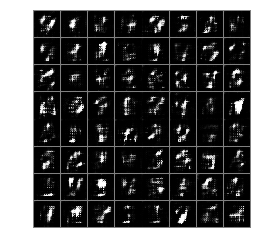

600 0.6944288 1.4308565 1.1082857 0.28057194
not training discriminator


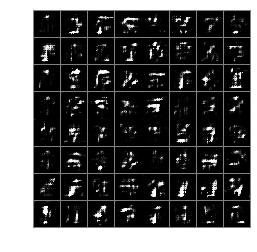

650 0.5882713 1.3186061 0.8517186 0.32482398
not training discriminator


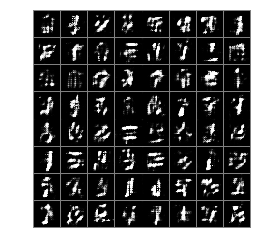

700 0.6445672 1.4571393 1.0164516 0.27268267
not training discriminator


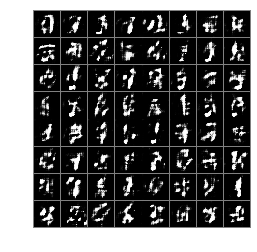

750 0.57126665 1.0263715 0.6793587 0.46317455


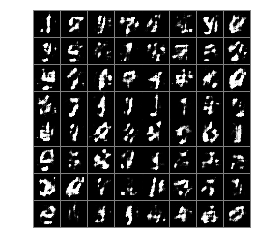

800 0.5617484 1.2269261 0.7439964 0.37950036
not training discriminator


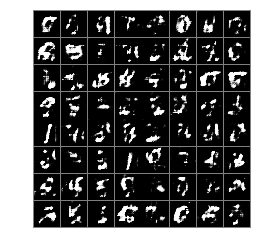

850 0.6112758 1.4734085 0.93944585 0.28310573
not training discriminator


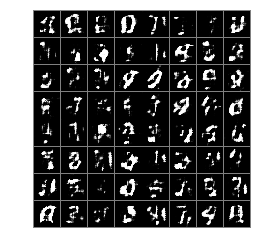

900 0.55707633 1.257869 0.74352664 0.3706262
not training discriminator


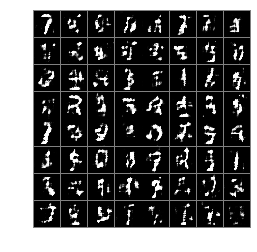

950 0.6352744 1.4585015 0.9779919 0.29255694
not training discriminator


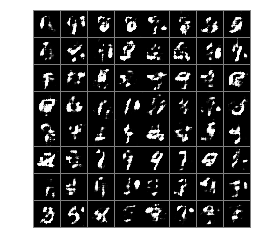

1000 0.7304982 1.5445411 1.2100327 0.2509638
not training discriminator


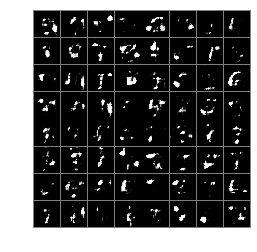

1050 0.59524477 1.3824098 0.8620995 0.32839
not training discriminator


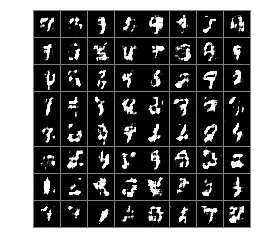

1100 0.64017045 1.4063693 0.9835917 0.29674935
not training discriminator


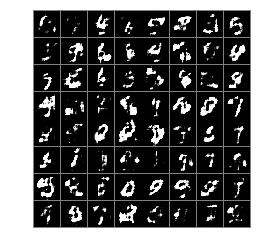

1150 0.57509774 1.2900376 0.805769 0.34442648
not training discriminator


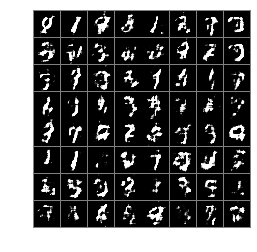

1200 0.6023612 0.64716375 0.3743628 0.8303596


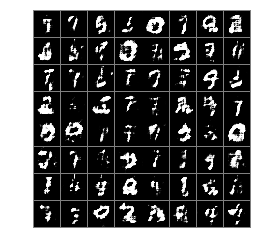

1250 0.5968417 1.5984311 0.9334773 0.2602061
not training discriminator


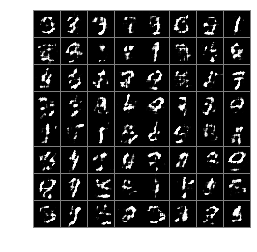

1300 0.559597 1.1628761 0.71482784 0.40436625
not training discriminator


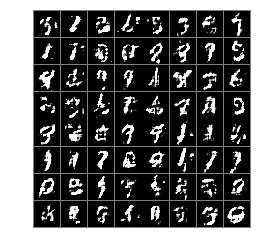

1350 0.5389704 0.8409337 0.43337405 0.6445668


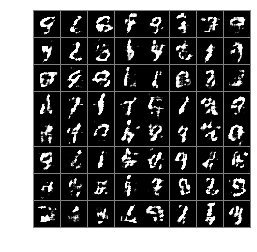

1400 0.56685776 1.4721692 0.8364625 0.297253
not training discriminator


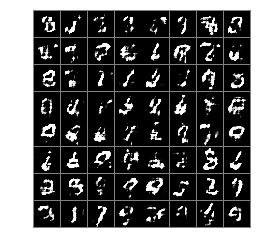

1450 0.6626382 1.6528097 1.0853469 0.23992959
not training discriminator


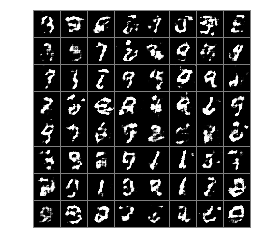

1500 0.56838286 1.0762632 0.66831803 0.46844763


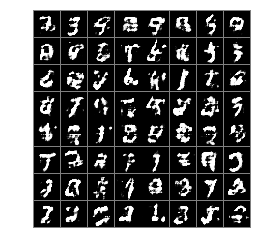

1550 0.7149881 1.6025579 1.1917175 0.23825862
not training discriminator


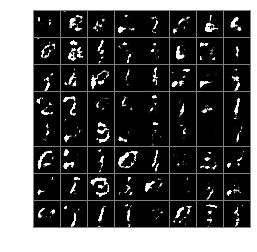

1600 0.633602 1.5612522 1.0093148 0.2578894
not training discriminator


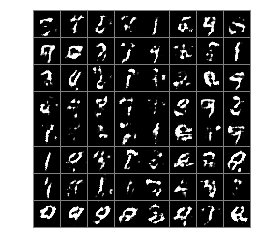

1650 0.556028 1.2247474 0.7206963 0.39135975
not training discriminator


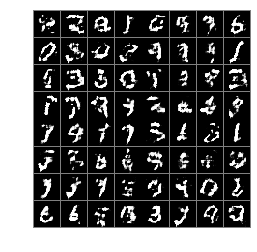

1700 0.6473248 1.3100905 0.95127153 0.34337807
not training discriminator


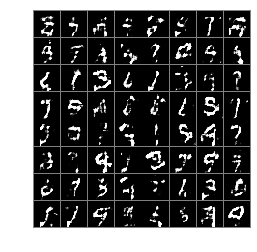

1750 0.56045926 1.3323526 0.7737498 0.34716865
not training discriminator


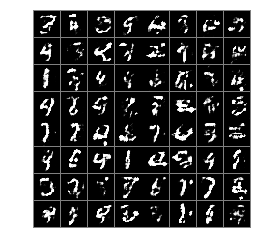

1800 0.61206746 1.3707539 0.89551455 0.3286204
not training discriminator


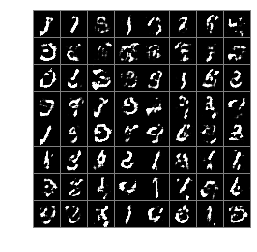

1850 0.6159469 1.3361715 0.89230263 0.33959103
not training discriminator


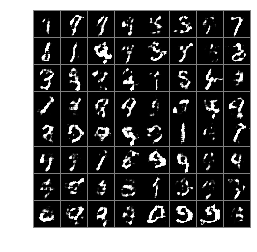

1900 0.6051378 1.4214157 0.89515686 0.31511873
not training discriminator


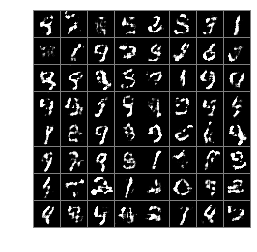

1950 0.65921587 1.590441 1.0739567 0.2444749
not training discriminator


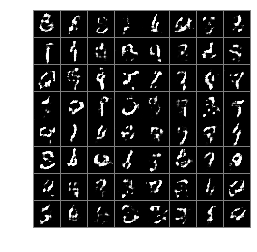

2000 0.69228685 1.5353016 1.122004 0.2625697
not training discriminator


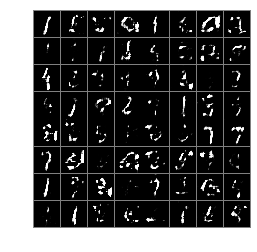

2050 0.6219826 1.4905348 0.9387094 0.3052559
not training discriminator


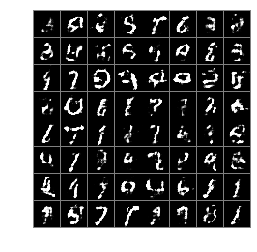

2100 0.57064486 1.3240377 0.7944274 0.34686238
not training discriminator


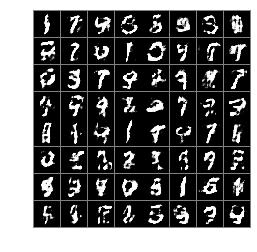

2150 0.5502939 1.2755225 0.7274657 0.3731221
not training discriminator


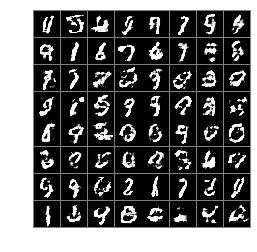

2200 0.52530515 1.321899 0.70939875 0.34121156
not training discriminator


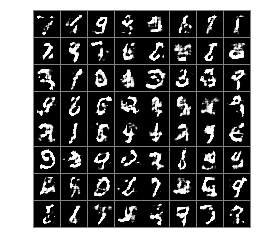

2250 0.56628585 1.4983711 0.85092074 0.28165108
not training discriminator


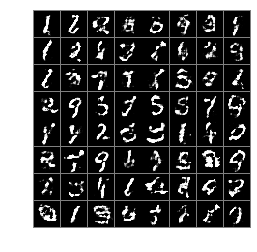

2300 0.56754005 1.3256636 0.77627754 0.35880262
not training discriminator


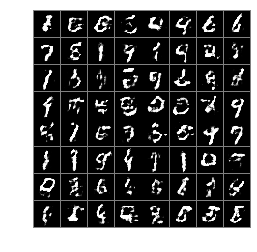

2350 0.6350132 1.5765716 1.0192378 0.25078863
not training discriminator


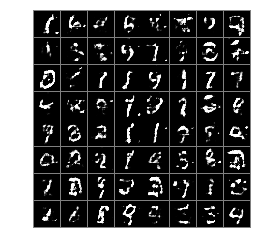

2400 0.6999315 1.5627201 1.1278609 0.27200198
not training discriminator


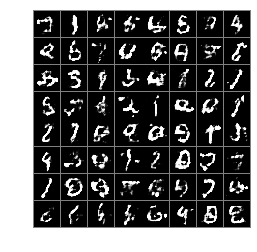

2450 0.6147025 0.48311067 0.15768467 1.0717204


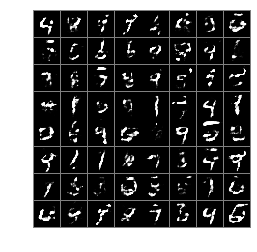

2500 0.5660188 1.4382563 0.8077035 0.3243342
not training discriminator


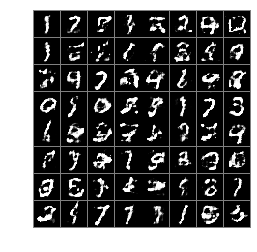

2550 0.5129079 1.0684912 0.55845726 0.4673586
not training discriminator


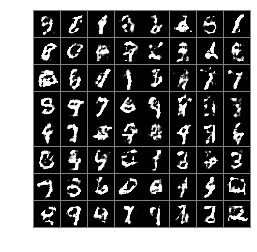

2600 0.5454321 1.3073053 0.71754086 0.37332326
not training discriminator


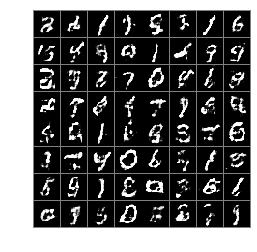

2650 0.6312492 1.2518876 0.9015798 0.36091858


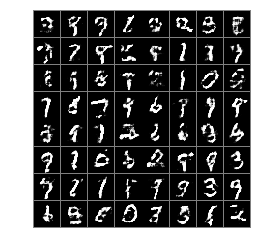

2700 0.5602401 1.3726386 0.7802175 0.34026265
not training discriminator


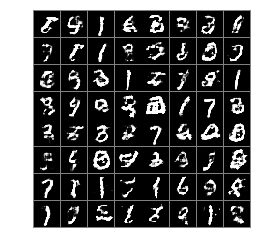

2750 0.58722305 1.2293026 0.8021431 0.372303
not training discriminator


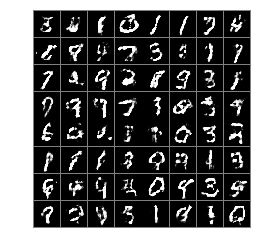

2800 0.5907397 1.2650094 0.819991 0.36148846
not training discriminator


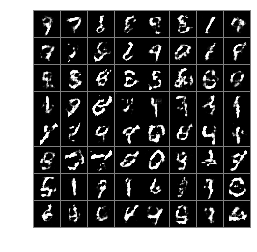

2850 0.60943127 1.4179556 0.92248225 0.29638022
not training discriminator


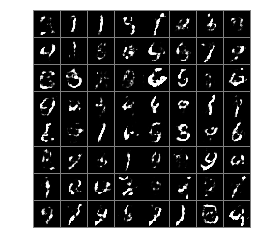

2900 0.47978973 0.7809521 0.25587484 0.7037046


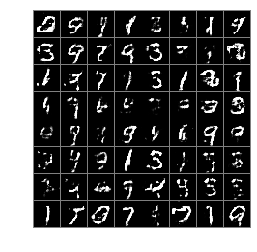

2950 0.60149175 1.3200926 0.8449607 0.3580226
not training discriminator


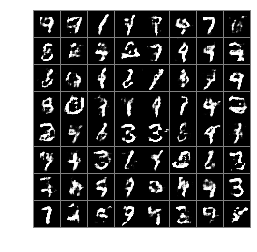

3000 0.5929723 1.3255363 0.8262529 0.35969174
not training discriminator


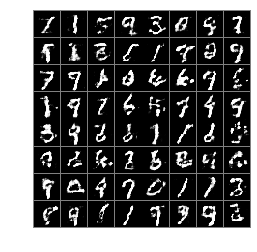

3050 0.6228881 1.2908508 0.88240016 0.36337602
not training discriminator


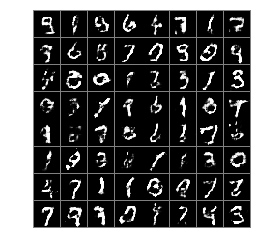

3100 0.6409338 1.5776505 1.0172268 0.26464084
not training discriminator


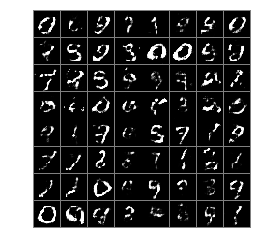

3150 0.65405405 1.342069 0.966336 0.34177214
not training discriminator


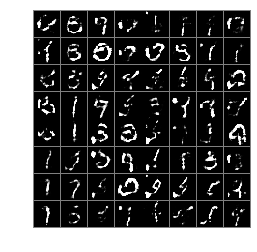

3200 0.65722185 1.5215952 1.0403022 0.2741416
not training discriminator


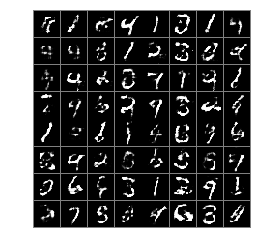

3250 0.69199586 1.6038254 1.1063118 0.27767986
not training discriminator


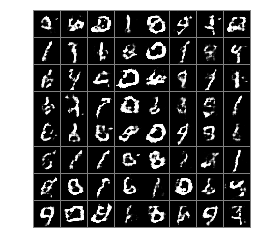

3300 0.66687906 1.7441707 1.1183805 0.21537775
not training discriminator


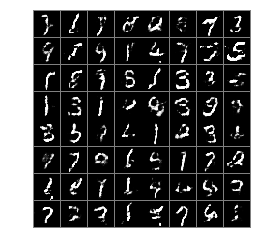

3350 0.54830813 1.0266373 0.59765697 0.4989594


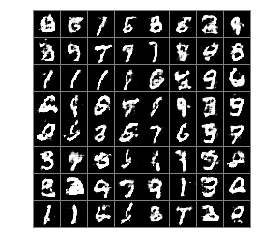

3400 0.6104051 1.3729621 0.88116467 0.33964533
not training discriminator


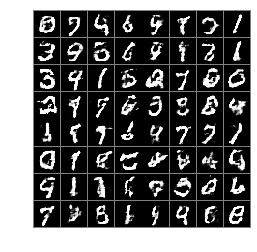

3450 0.57580066 1.560205 0.8908936 0.2607078
not training discriminator


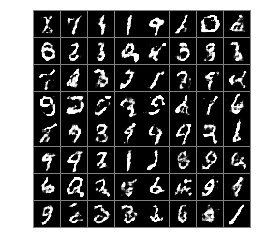

3500 0.65917957 1.5249088 1.0433385 0.27502063
not training discriminator


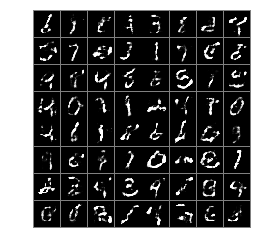

3550 0.51297814 1.2678049 0.63945615 0.38650018
not training discriminator


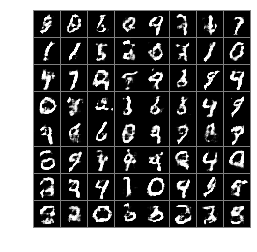

3600 0.4535355 0.9492289 0.30502093 0.60205007
not training discriminator


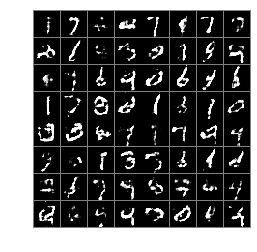

3650 0.6694241 1.3052057 0.98601973 0.3528284


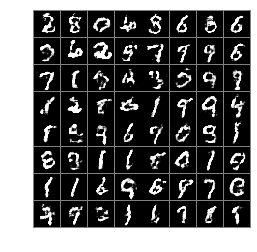

3700 0.5090632 0.97861445 0.4792831 0.5388433


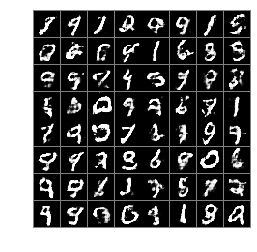

3750 0.61100006 1.417031 0.8871739 0.33482617
not training discriminator


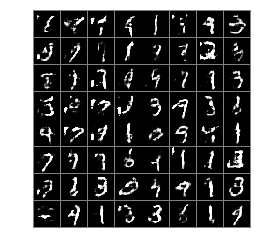

3800 0.59965163 1.4030488 0.8867365 0.3125667
not training discriminator


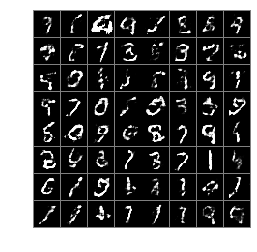

3850 0.6218898 1.5132911 0.9661535 0.2776261
not training discriminator


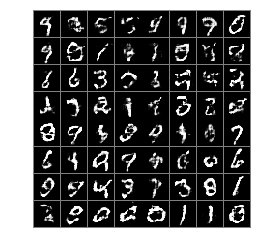

3900 0.66118014 1.4062058 0.99335134 0.32900903
not training discriminator


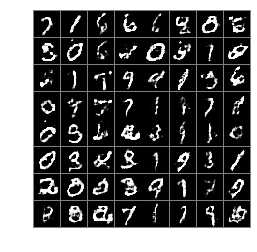

3950 0.54395926 1.2209496 0.68195677 0.4059618
not training discriminator


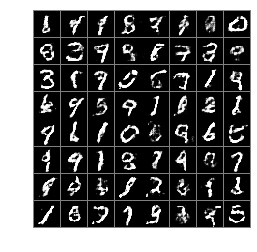

4000 0.55383635 0.8018693 0.46575058 0.641922


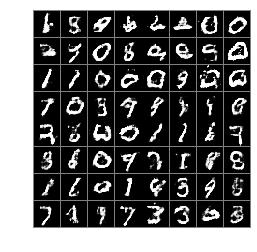

4050 0.65015817 1.623961 1.0591798 0.24113658
not training discriminator


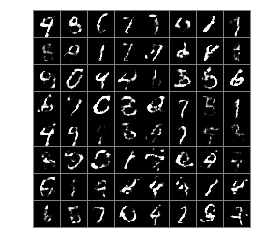

4100 0.61635715 1.3103666 0.88307786 0.34963647
not training discriminator


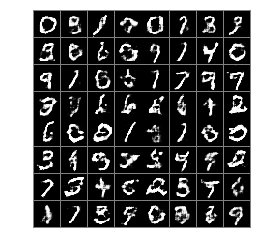

4150 0.57542586 0.7855873 0.47979796 0.6710538


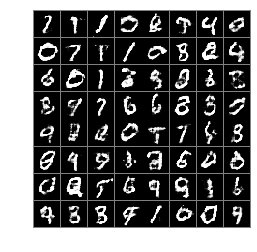

4200 0.6254155 1.4735748 0.9447094 0.30612153
not training discriminator


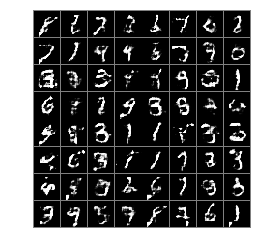

4250 0.6244352 1.2993553 0.85662436 0.39224613
not training discriminator


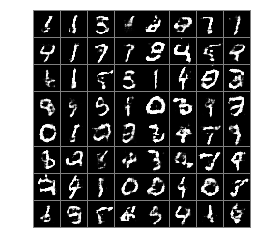

4300 0.56006646 1.3373494 0.77013296 0.3499999
not training discriminator


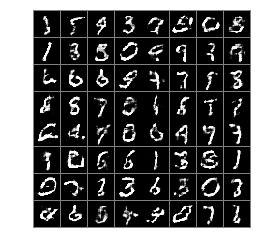

4350 0.6375673 1.3657143 0.94092155 0.33421302
not training discriminator


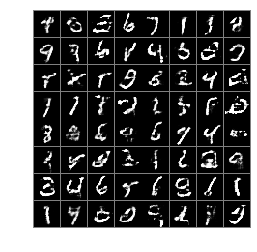

4400 0.6092614 1.5961492 0.95817786 0.26034486
not training discriminator


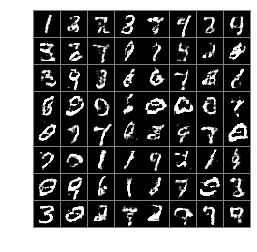

4450 0.60402966 1.272152 0.823277 0.3847822
not training discriminator


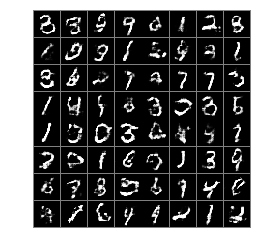

4500 0.59532547 1.2679884 0.8056697 0.38498122
not training discriminator


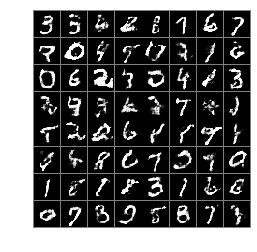

4550 0.56442535 1.2075565 0.7406197 0.38823098
not training discriminator


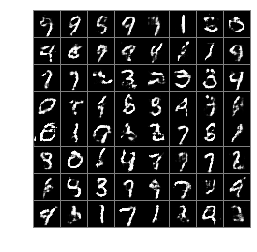

4600 0.6295457 1.3332846 0.9155759 0.3435154
not training discriminator


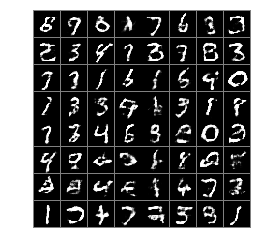

4650 0.6040716 1.326062 0.86087 0.3472733
not training discriminator


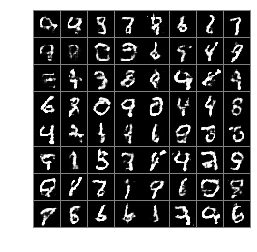

4700 0.5734564 1.2442005 0.74101746 0.4058954
not training discriminator


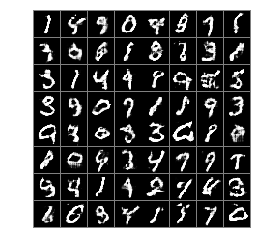

4750 0.5692169 0.8830922 0.51014495 0.62828887


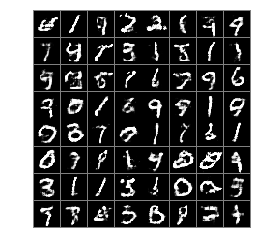

4800 0.55544627 1.0466042 0.62024176 0.4906508


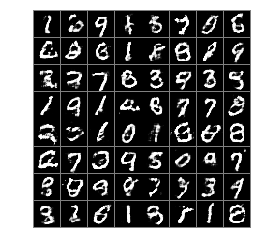

4850 0.53572947 1.2959007 0.6982924 0.37316662
not training discriminator


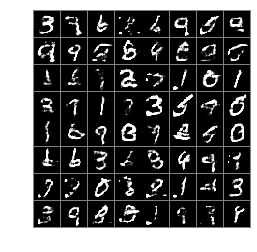

4900 0.55695224 1.274126 0.7401754 0.37372905
not training discriminator


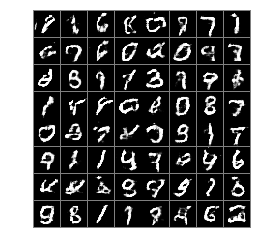

4950 0.6231059 1.4124252 0.93517244 0.31103942
not training discriminator


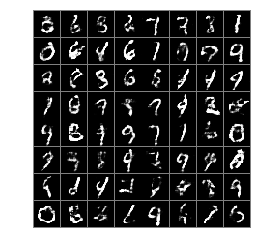

5000 0.7093543 1.5847527 1.1680149 0.25069368
not training discriminator


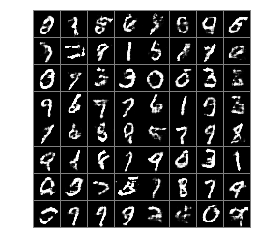

5050 0.6001583 1.3242803 0.84584475 0.3544718
not training discriminator


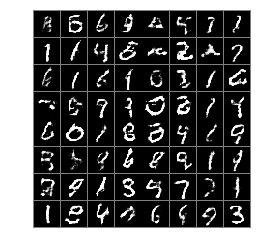

5100 0.5889536 1.3089464 0.82430935 0.35359794
not training discriminator


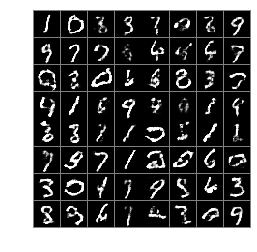

5150 0.5354909 1.0036097 0.5501566 0.52082515


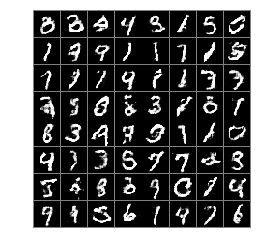

5200 0.45637816 1.2509704 0.52328193 0.38947433
not training discriminator


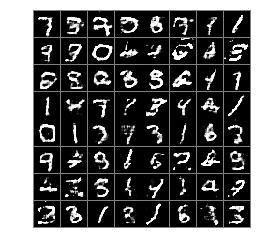

5250 0.71705717 1.5831153 1.1668079 0.2673066
not training discriminator


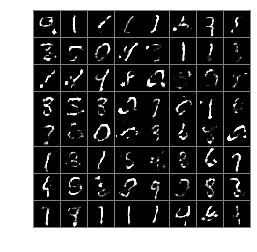

5300 0.62445104 1.550521 0.9690074 0.2798947
not training discriminator


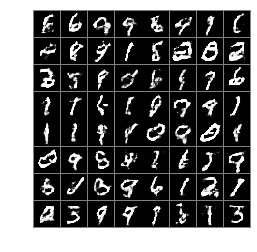

5350 0.638039 1.2622609 0.89551795 0.38056004


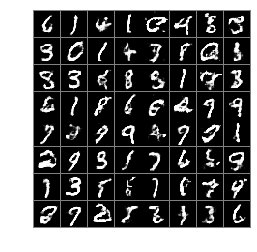

5400 0.629467 1.4607747 0.960473 0.298461
not training discriminator


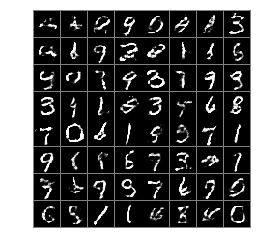

5450 0.6934211 1.2875361 0.97169405 0.41514814


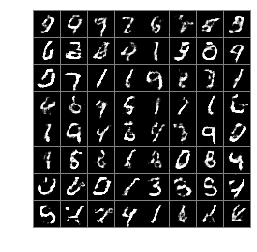

5500 0.71006763 1.5395916 1.146307 0.2738284
not training discriminator


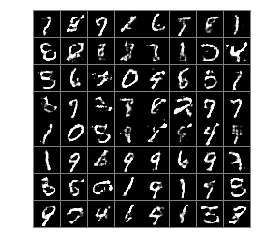

5550 0.5790744 0.7651913 0.42708838 0.73106045


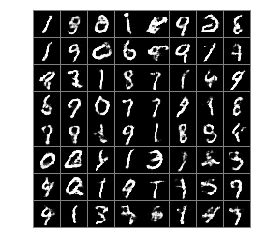

5600 0.5770446 1.2604349 0.76577425 0.3883149
not training discriminator


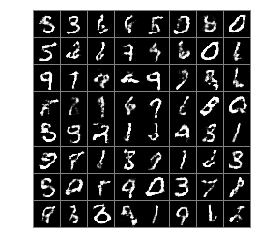

5650 0.54320204 1.1532027 0.66128075 0.42512327
not training discriminator


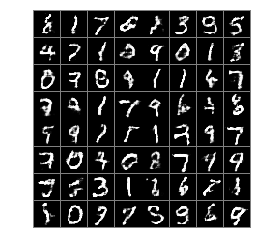

5700 0.5712883 1.2214932 0.7520732 0.3905033
not training discriminator


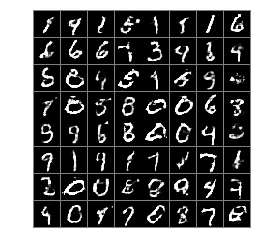

5750 0.64514846 1.5372417 0.98599565 0.30430132
not training discriminator


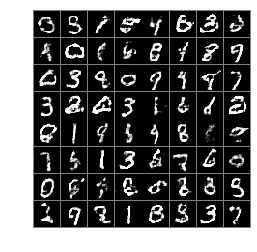

5800 0.57820547 1.1935811 0.753696 0.40271485
not training discriminator


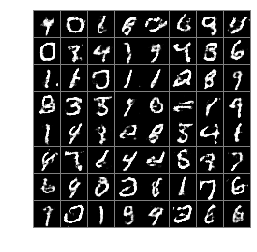

5850 0.6592162 1.4806969 1.0205462 0.29788646
not training discriminator


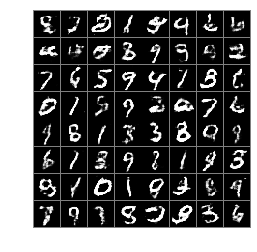

5900 0.577716 0.71423185 0.39971262 0.7557194


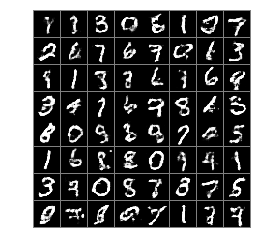

5950 0.6476104 0.6405791 0.36822495 0.9269959


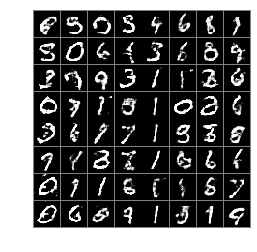

6000 0.5608336 0.79646045 0.44689235 0.67477477


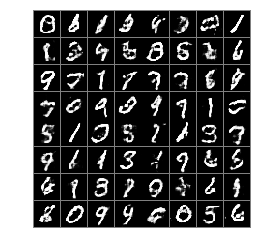

6050 0.6347376 1.4194849 0.9507265 0.3187486
not training discriminator


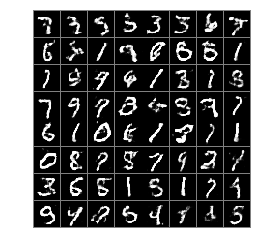

6100 0.5841801 1.3680117 0.84067446 0.32768583
not training discriminator


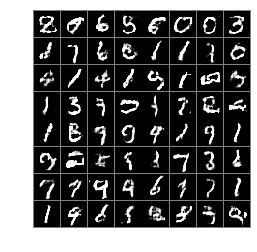

6150 0.52382016 1.2390697 0.6508791 0.3967613
not training discriminator


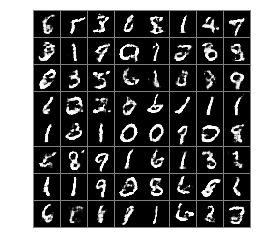

6200 0.59061044 1.5163015 0.88549787 0.29572305
not training discriminator


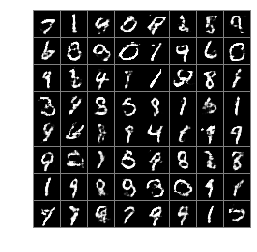

6250 0.6402919 1.6318675 1.0308625 0.24972138
not training discriminator


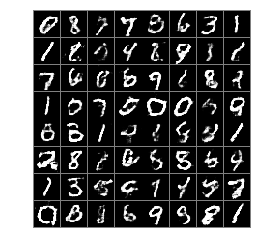

6300 0.6073381 1.3404325 0.87293077 0.34174544
not training discriminator


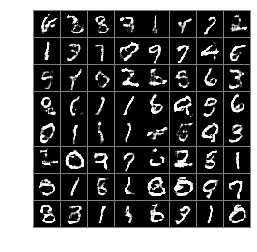

6350 0.5513477 1.1698246 0.6863495 0.4163458
not training discriminator


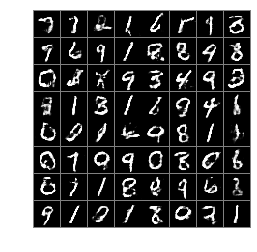

6400 0.55663085 1.1218467 0.67772114 0.43554056
not training discriminator


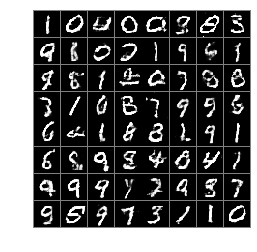

6450 0.5645963 1.3689924 0.79226744 0.3369252
not training discriminator


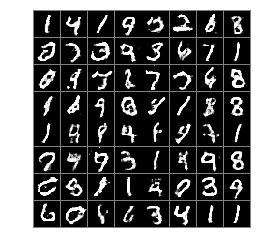

6500 0.5300771 0.87615395 0.4734664 0.5866878


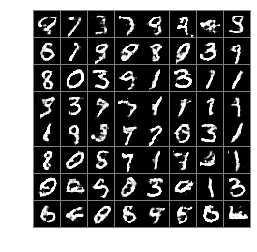

6550 0.6675362 1.4305006 1.0245887 0.31048375
not training discriminator


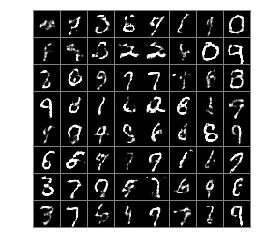

6600 0.6351639 1.5079689 0.9874679 0.28285995
not training discriminator


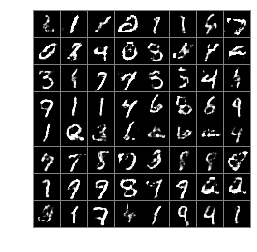

6650 0.6790689 1.5262517 1.0628992 0.29523858
not training discriminator


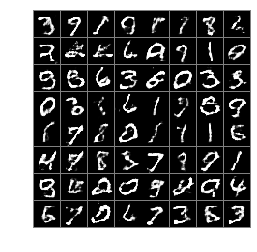

6700 0.6596262 1.109565 0.87364155 0.4456108


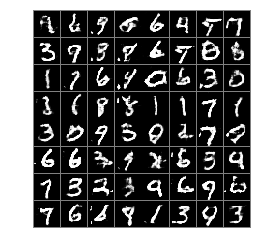

6750 0.6334145 1.1525133 0.8222327 0.44459623


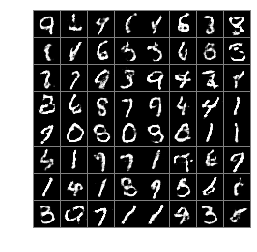

6800 0.548167 1.3438553 0.74349093 0.3528431
not training discriminator


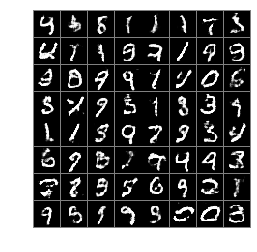

6850 0.5634638 1.2200205 0.71964586 0.40728182
not training discriminator


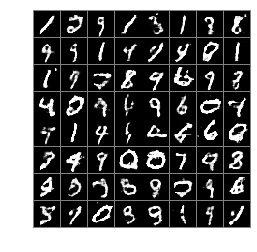

6900 0.63361466 1.2276629 0.8668194 0.40041


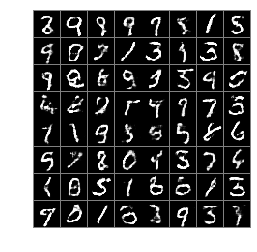

6950 0.64953697 1.5333681 1.0251585 0.27391553
not training discriminator


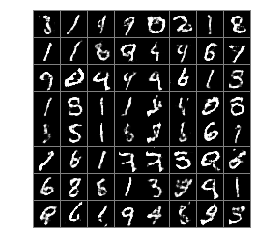

7000 0.65096855 1.7398381 1.0596046 0.24233255
not training discriminator


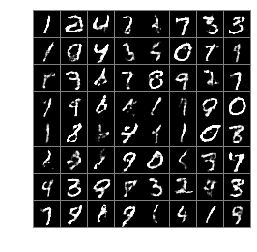

7050 0.59848505 1.2765436 0.831625 0.36534518
not training discriminator


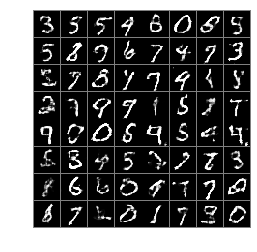

7100 0.56142926 1.158014 0.6878844 0.43497407
not training discriminator


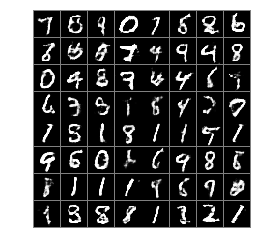

7150 0.542248 1.199066 0.68533164 0.3991644
not training discriminator


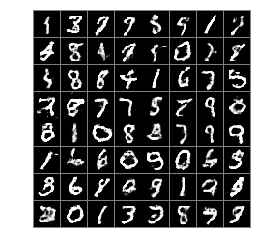

7200 0.68418777 1.579361 1.1036611 0.26471442
not training discriminator


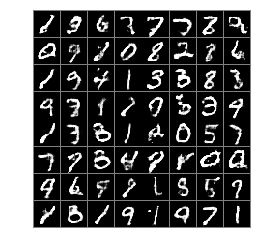

7250 0.55955625 1.2264574 0.728325 0.39078754
not training discriminator


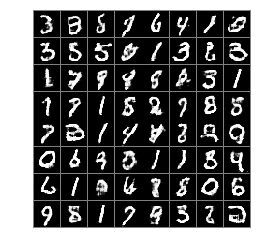

7300 0.56477404 1.2402611 0.75033146 0.37921658
not training discriminator


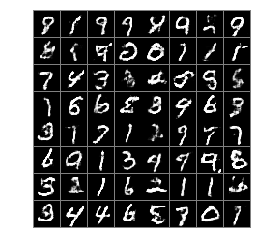

7350 0.63266087 1.2359331 0.8768522 0.38846952


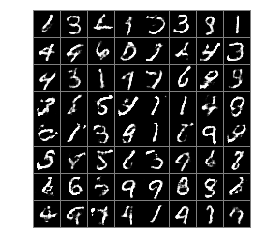

7400 0.63504004 1.2893549 0.9145801 0.35549995
not training discriminator


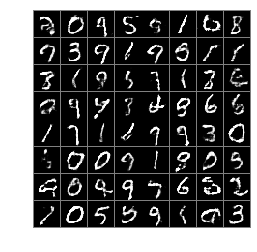

7450 0.5705083 1.14007 0.6879586 0.45305794


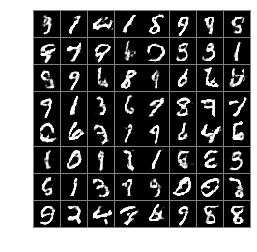

7500 0.57234836 1.0994198 0.68918884 0.4555078


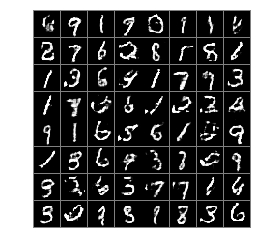

7550 0.5375609 1.1855347 0.67847264 0.39664906
not training discriminator


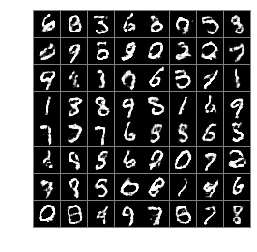

7600 0.626096 1.1151196 0.79553854 0.45665348


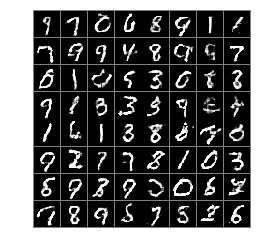

7650 0.63296884 0.5971915 0.37677547 0.8891621


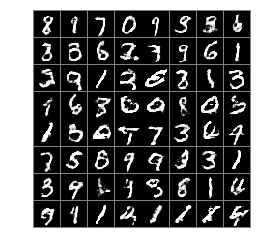

7700 0.63105595 1.2812924 0.895265 0.36684698
not training discriminator


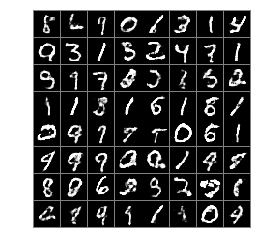

7750 0.5648433 1.1984646 0.73974633 0.38994032
not training discriminator


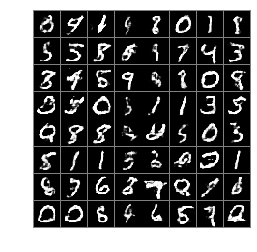

7800 0.59670496 1.3328543 0.84836376 0.34504607
not training discriminator


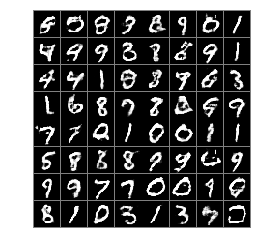

7850 0.539147 1.3519751 0.7356738 0.34262022
not training discriminator


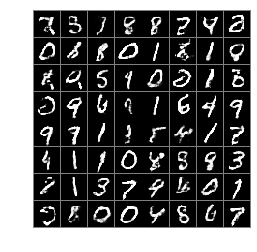

7900 0.61093205 1.4005849 0.9035337 0.3183304
not training discriminator


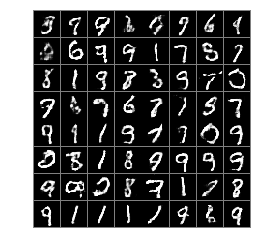

7950 0.5775535 0.8353902 0.4529798 0.7021272


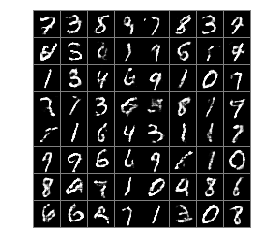

8000 0.6921031 1.3909622 1.0351187 0.34908742
not training discriminator


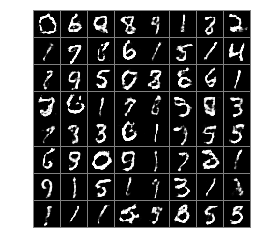

8050 0.593651 1.3432994 0.8460122 0.34128985
not training discriminator


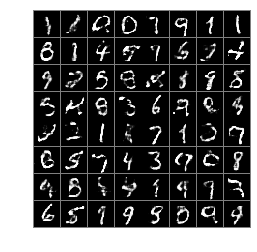

8100 0.6627917 1.4874924 1.0200151 0.30556834
not training discriminator


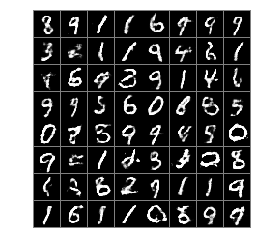

8150 0.63859373 1.469216 0.983034 0.2941535
not training discriminator


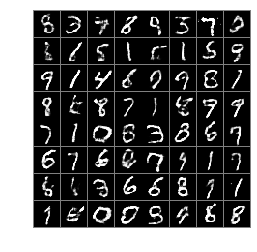

8200 0.68084264 1.6240561 1.1134799 0.24820548
not training discriminator


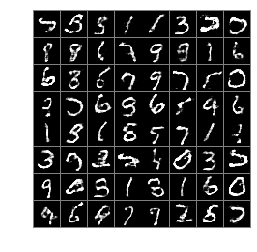

8250 0.5536348 1.2966955 0.73979604 0.36747354
not training discriminator


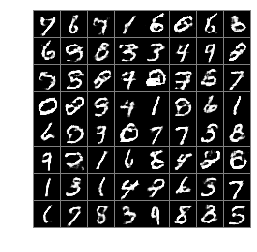

8300 0.6254945 1.4390416 0.92485344 0.3261355
not training discriminator


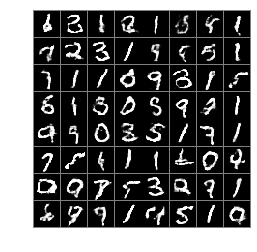

8350 0.5687518 1.2590221 0.74894124 0.38856247
not training discriminator


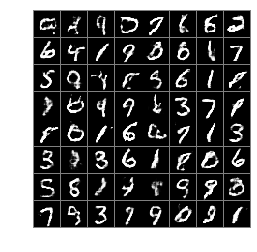

8400 0.56827176 1.249203 0.73796517 0.39857835
not training discriminator


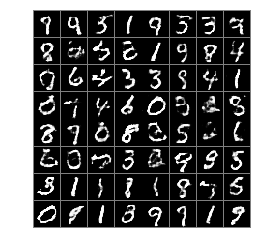

8450 0.608659 0.64555335 0.36696726 0.85035074


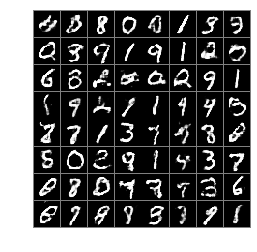

8500 0.55045724 1.1118028 0.65399027 0.4469242
not training discriminator


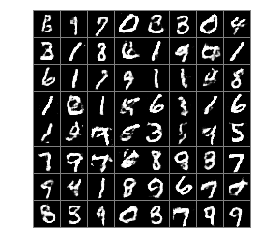

8550 0.565659 0.7787305 0.4432807 0.68803716


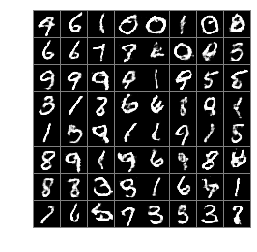

8600 0.6167248 1.2365978 0.83108056 0.40236902
not training discriminator


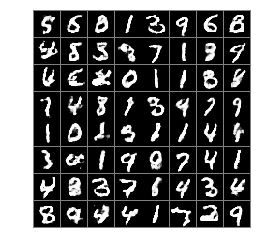

8650 0.5247252 1.3305855 0.6922934 0.357157
not training discriminator


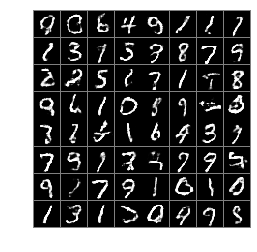

8700 0.5628331 1.3961253 0.7983253 0.32734084
not training discriminator


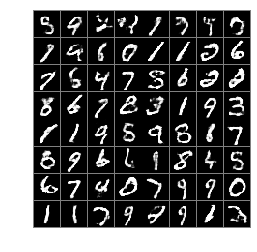

8750 0.6171794 1.4342717 0.9237813 0.31057754
not training discriminator


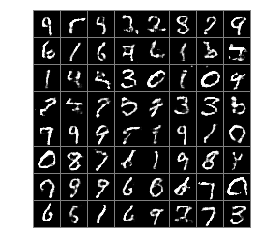

8800 0.6027353 1.347056 0.82712424 0.37834626
not training discriminator


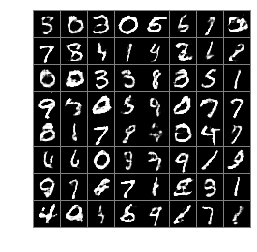

8850 0.5881432 1.420605 0.86757874 0.30870777
not training discriminator


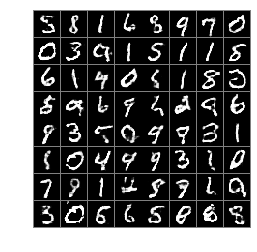

8900 0.5915893 1.4724805 0.8744633 0.3087152
not training discriminator


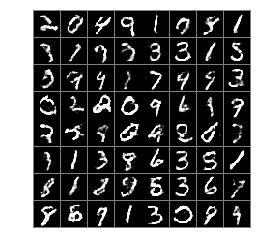

8950 0.568661 0.81763655 0.48310244 0.6542194


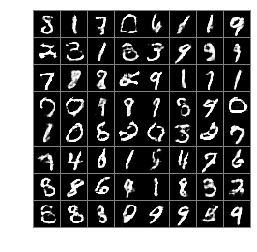

9000 0.64841527 1.3213172 0.93014365 0.36668694
not training discriminator


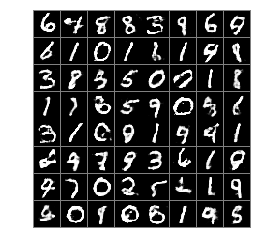

9050 0.56977737 1.0890226 0.6918404 0.44771433


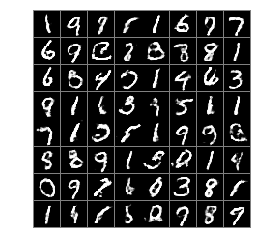

9100 0.681868 0.4759015 0.2956698 1.0680662


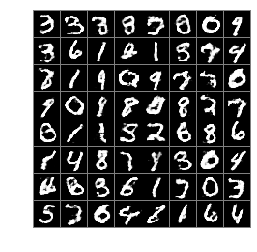

9150 0.5846015 1.3390274 0.81468874 0.3545143
not training discriminator


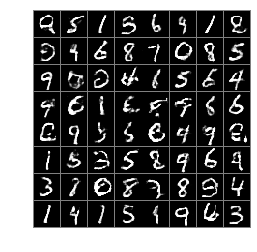

9200 0.57681465 1.3873358 0.8262044 0.32742494
not training discriminator


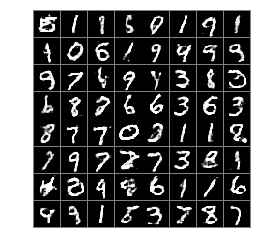

9250 0.63500226 1.1997278 0.87040627 0.3995983


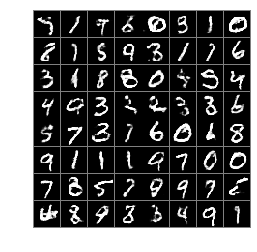

9300 0.6473478 1.2040823 0.90399754 0.39069813


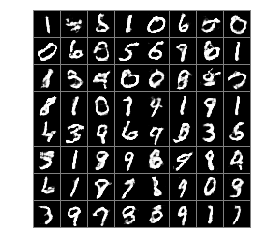

9350 0.57720745 1.3397464 0.8123337 0.34208113
not training discriminator


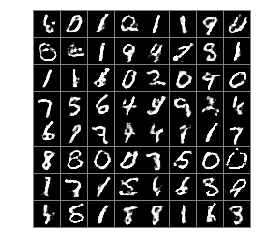

9400 0.6042902 1.2318368 0.8127027 0.39587766
not training discriminator


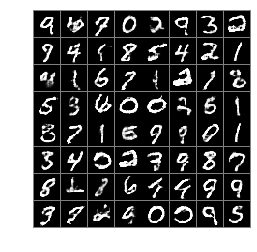

9450 0.5863013 1.554451 0.90085626 0.27174634
not training discriminator


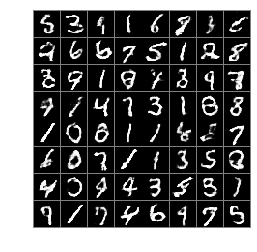

9500 0.5966159 1.2358067 0.8004356 0.39279622
not training discriminator


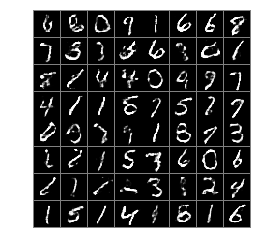

9550 0.665603 1.3043792 0.97626823 0.35493776


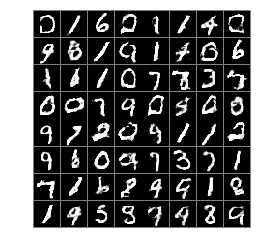

9600 0.5329666 1.3470793 0.72893953 0.3369937
not training discriminator


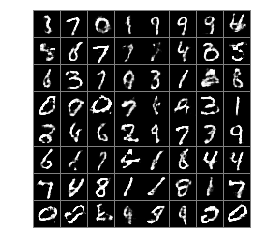

9650 0.6949284 1.4820148 1.104187 0.28566974
not training discriminator


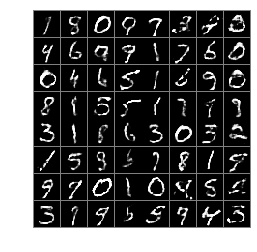

9700 0.5547025 1.3782108 0.7712631 0.33814174
not training discriminator


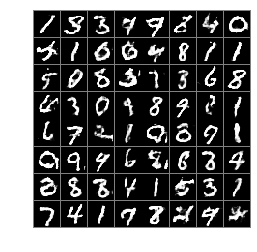

9750 0.5849288 1.2857124 0.79735625 0.3725013
not training discriminator


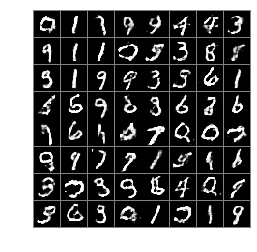

9800 0.6564474 1.2394812 0.8906398 0.42225504


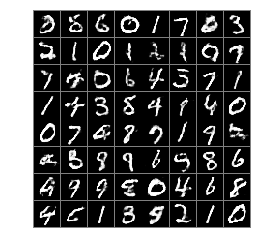

9850 0.6106102 1.231811 0.8371291 0.38409117
not training discriminator


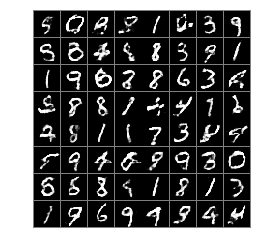

9900 0.60512304 1.0984442 0.7202989 0.48994735


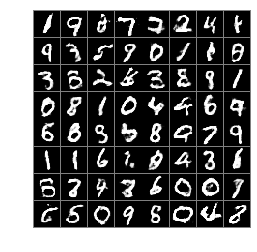

9950 0.6474047 1.4539136 0.9933819 0.30142742
not training discriminator


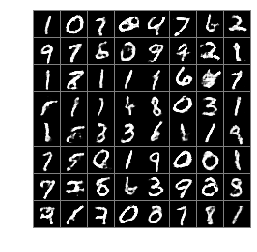

10000 0.5369866 0.8234742 0.42581162 0.6481615


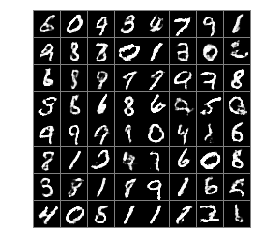

10050 0.5807781 1.1625001 0.7304276 0.43112868
not training discriminator


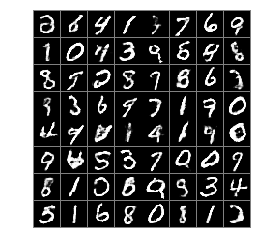

10100 0.51974076 1.1055398 0.58832467 0.45115682
not training discriminator


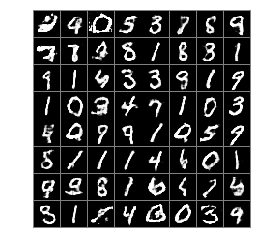

10150 0.5320499 1.220084 0.65486807 0.40923172
not training discriminator


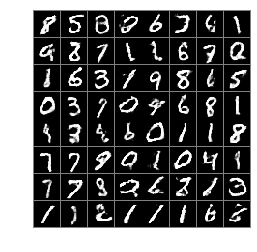

10200 0.59198475 1.2821031 0.81457293 0.3693965
not training discriminator


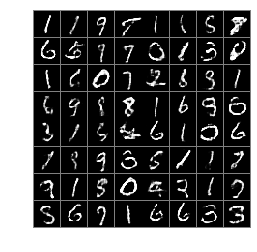

10250 0.7256686 1.5984919 1.198111 0.2532261
not training discriminator


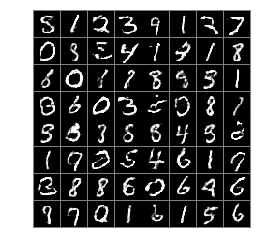

10300 0.66248834 1.5366405 1.0307057 0.2942709
not training discriminator


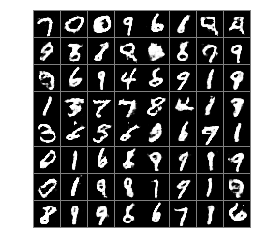

10350 0.62176186 1.3056761 0.88508344 0.35844022
not training discriminator


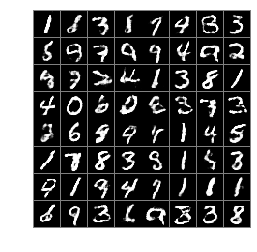

10400 0.55174845 1.2020986 0.69445807 0.4090388
not training discriminator


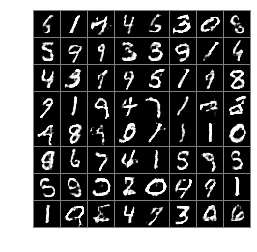

10450 0.66299784 1.5867448 1.0648428 0.26115277
not training discriminator


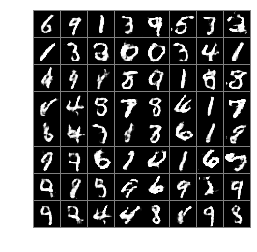

10500 0.53943455 1.1259093 0.6241083 0.4547609
not training discriminator


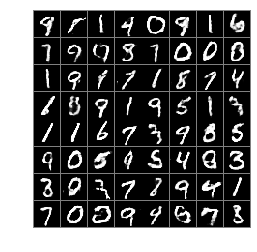

10550 0.5502467 0.9564177 0.55682826 0.5436653


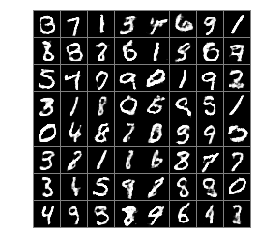

10600 0.5478436 1.2422729 0.71324635 0.38244092
not training discriminator


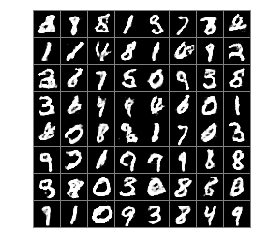

10650 0.72824657 1.6887755 1.1863964 0.27009663
not training discriminator


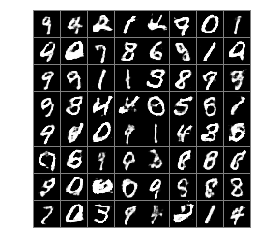

10700 0.6191072 1.3018554 0.8580651 0.38014928
not training discriminator


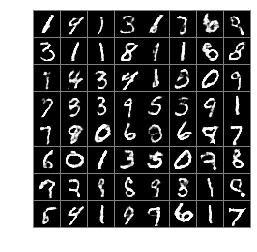

10750 0.6521112 1.3349303 0.92141634 0.38280612
not training discriminator


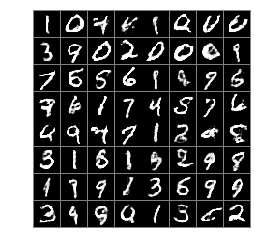

10800 0.6737056 1.3124905 0.9932766 0.3541346


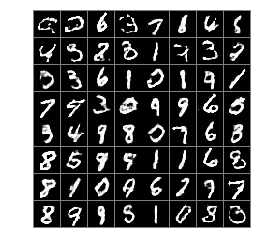

10850 0.628062 1.1435164 0.80947953 0.44664437


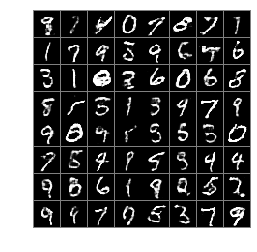

10900 0.56152993 1.3064694 0.7686372 0.3544227
not training discriminator


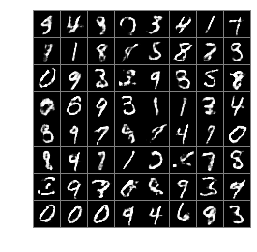

10950 0.6086525 1.4848117 0.9203341 0.29697073
not training discriminator


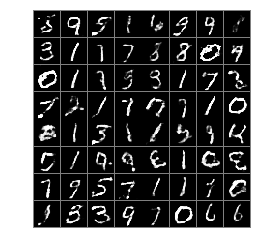

11000 0.53982306 1.119448 0.61452854 0.46511763
not training discriminator


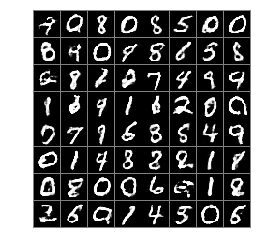

11050 0.589083 1.5248984 0.89549476 0.2826713
not training discriminator


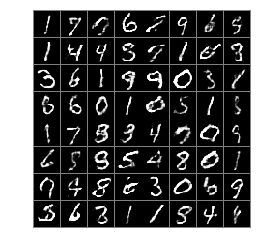

11100 0.67535293 1.6197975 1.0755358 0.27517006
not training discriminator


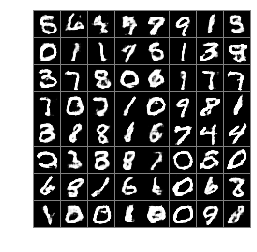

11150 0.5465865 1.6473784 0.83568126 0.25749177
not training discriminator


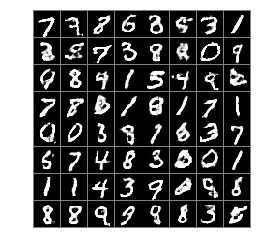

11200 0.6056688 1.5304866 0.93137914 0.2799585
not training discriminator


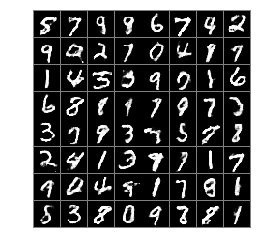

11250 0.5963684 1.2585318 0.8118839 0.38085276
not training discriminator


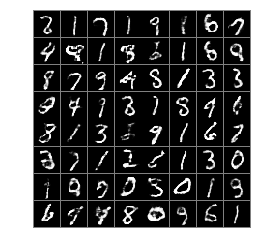

11300 0.5596028 1.0885607 0.6523319 0.46687362


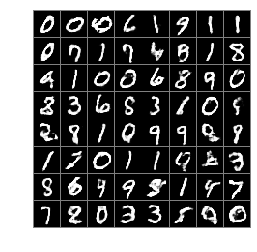

11350 0.6027654 1.3353761 0.8487909 0.35673982
not training discriminator


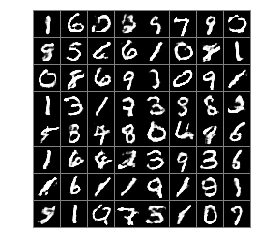

11400 0.6219599 1.345225 0.87968254 0.36423728
not training discriminator


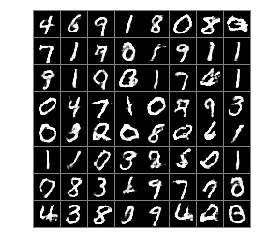

11450 0.5932784 1.4572872 0.88361263 0.30294424
not training discriminator


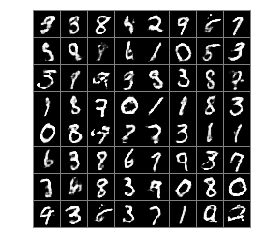

11500 0.56807184 0.80133176 0.4735878 0.662556


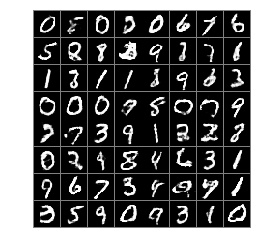

11550 0.5409905 1.3539975 0.7298144 0.35216644
not training discriminator


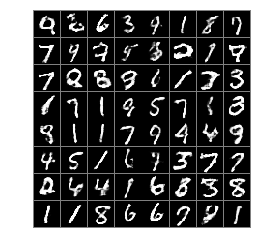

11600 0.52996945 1.4185922 0.74852765 0.31141123
not training discriminator


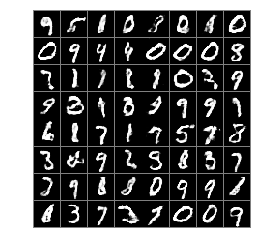

11650 0.5923387 1.348726 0.84716 0.3375175
not training discriminator


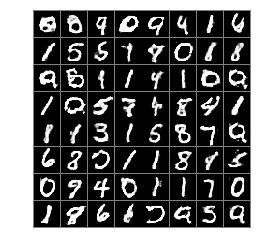

11700 0.59455025 1.4350066 0.880928 0.3081725
not training discriminator


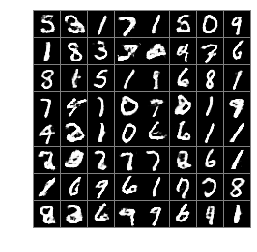

11750 0.65616775 1.5598226 1.0425026 0.26983288
not training discriminator


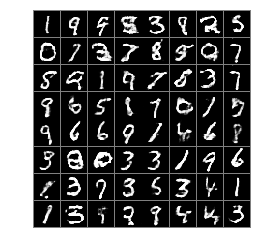

11800 0.49841252 0.9615651 0.45138252 0.5454425


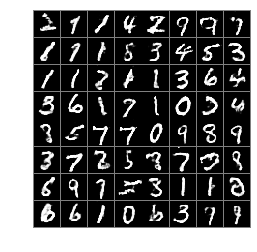

11850 0.4513948 0.96171314 0.34776628 0.55502325
not training discriminator


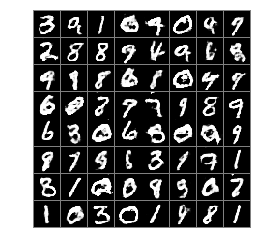

11900 0.55908585 1.2731673 0.7525966 0.36557513
not training discriminator


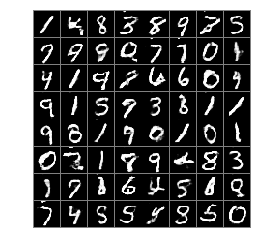

11950 0.7073035 1.3274388 1.0403758 0.37423113


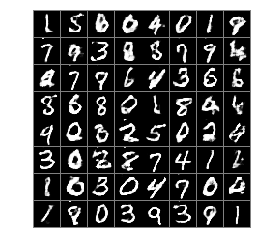

12000 0.595056 1.1321657 0.7497691 0.4403429


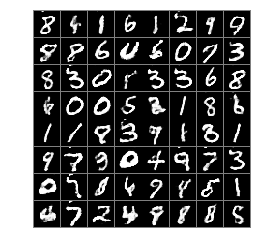

12050 0.68226755 0.44710585 0.26368326 1.1008518
not training generator


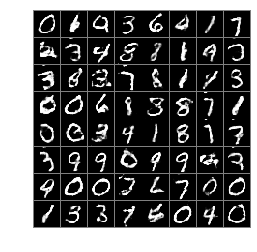

12100 0.5612925 1.1057495 0.6834875 0.43909752


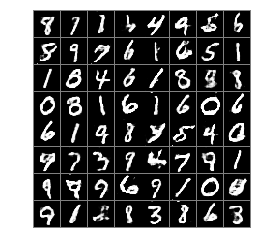

12150 0.5910392 1.3617373 0.83043003 0.3516484
not training discriminator


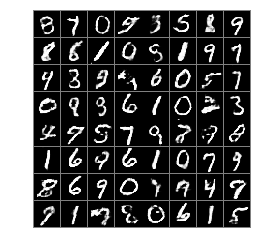

12200 0.6199943 1.5151262 0.9538357 0.28615284
not training discriminator


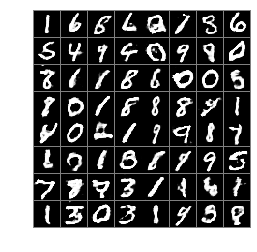

12250 0.5762261 1.1226501 0.69317573 0.4592765


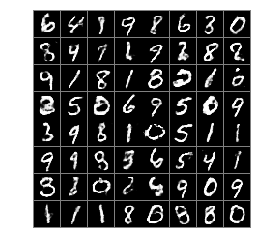

12300 0.5830844 1.258485 0.7946012 0.37156758
not training discriminator


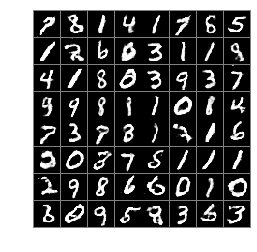

12350 0.5700943 1.244375 0.75206506 0.38812357
not training discriminator


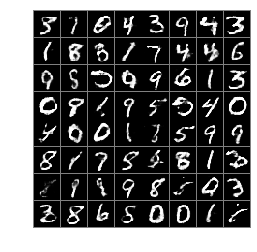

12400 0.6339817 0.5808567 0.34339765 0.9245657


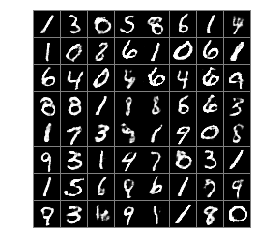

12450 0.58541083 1.4341615 0.86445487 0.30636677
not training discriminator


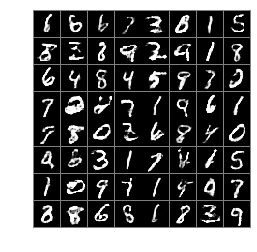

12500 0.5456923 0.99932635 0.5725137 0.51887095


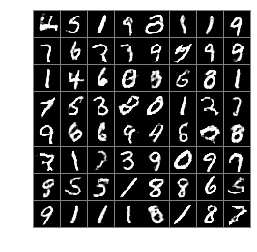

12550 0.55899715 1.0918534 0.6351445 0.48284984


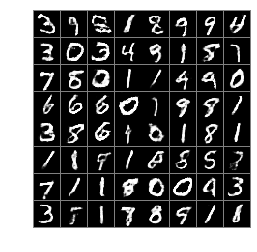

12600 0.56227523 0.7583177 0.4386214 0.685929


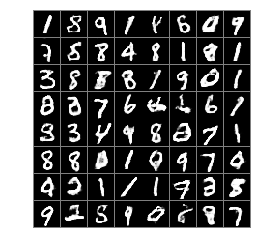

12650 0.63524956 1.2015806 0.8277011 0.44279805


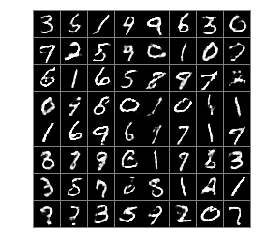

12700 0.5597555 1.396439 0.80347776 0.31603327
not training discriminator


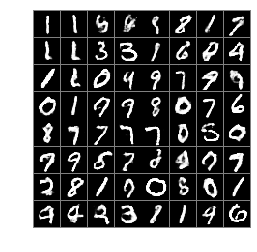

12750 0.48470682 1.2145007 0.57350737 0.3959062
not training discriminator


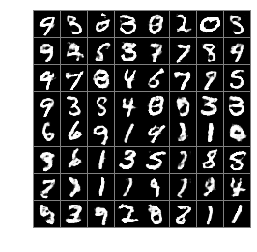

12800 0.5693584 1.3693092 0.7761304 0.36258644
not training discriminator


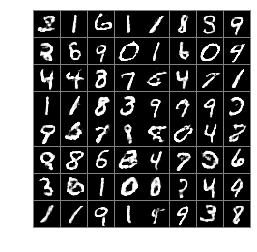

12850 0.5757403 1.1977878 0.73790187 0.4135787
not training discriminator


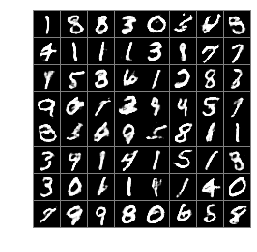

12900 0.53188306 1.1354074 0.6358267 0.42793941
not training discriminator


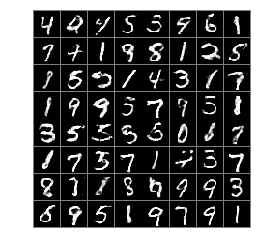

12950 0.57781327 0.6844449 0.3534941 0.80213237


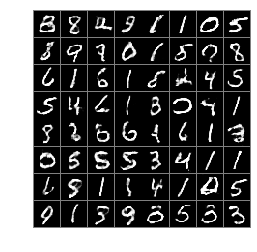

13000 0.6416275 1.4257958 0.959463 0.323792
not training discriminator


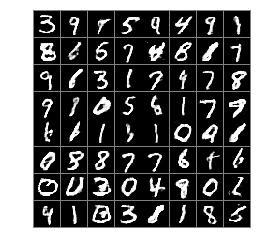

13050 0.6055213 1.3699374 0.8742313 0.33681142
not training discriminator


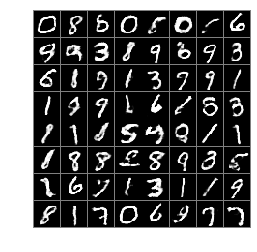

13100 0.6108713 1.4654922 0.8982539 0.32348877
not training discriminator


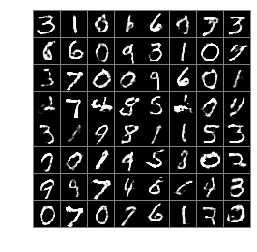

13150 0.5893917 1.6719515 0.91705847 0.26172486
not training discriminator


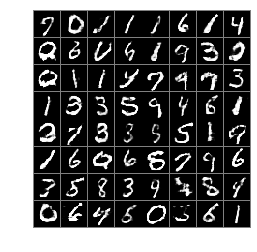

13200 0.55706453 1.3653477 0.7753676 0.33876133
not training discriminator


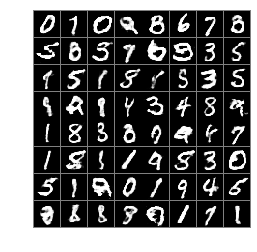

13250 0.5955134 1.456812 0.89144284 0.2995839
not training discriminator


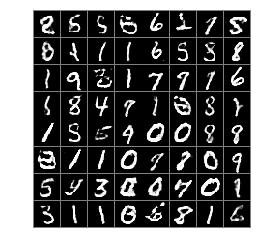

13300 0.50404686 1.4560139 0.6954489 0.3126449
not training discriminator


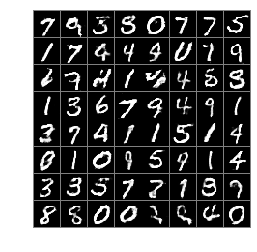

13350 0.5625673 1.3346295 0.77422523 0.35090938
not training discriminator


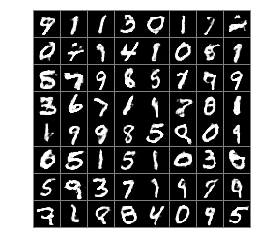

13400 0.5572616 1.2265005 0.7072332 0.40728995
not training discriminator


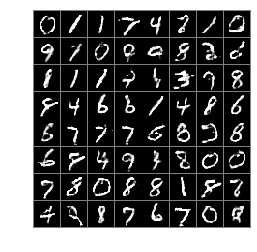

13450 0.60822564 1.3990653 0.90002215 0.31642914
not training discriminator


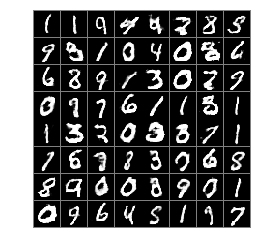

13500 0.56398594 1.2147019 0.718511 0.40946087
not training discriminator


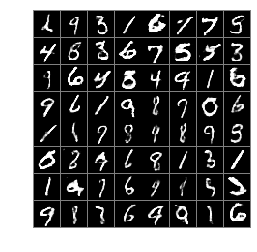

13550 0.61547315 1.5868543 0.9539616 0.27698472
not training discriminator


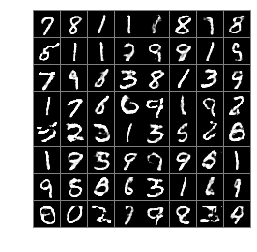

13600 0.60026467 1.2208855 0.7814729 0.41905653
not training discriminator


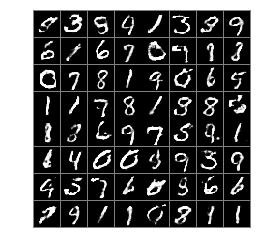

13650 0.5106684 1.1974821 0.61541194 0.40592498
not training discriminator


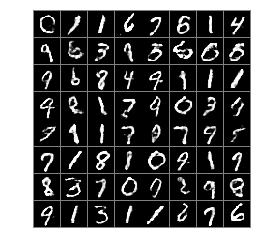

13700 0.5847805 1.2696283 0.77607757 0.39348346
not training discriminator


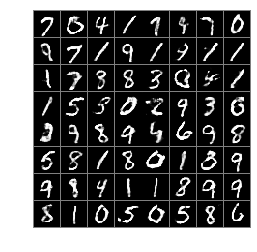

13750 0.5997728 1.3946872 0.86720157 0.33234406
not training discriminator


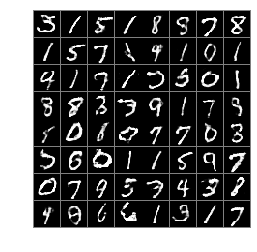

13800 0.5438575 1.1258367 0.6570475 0.43066746
not training discriminator


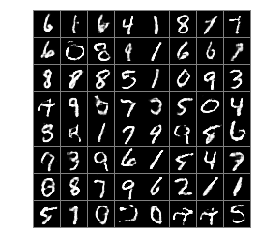

13850 0.63059103 1.5296602 0.9795694 0.28161275
not training discriminator


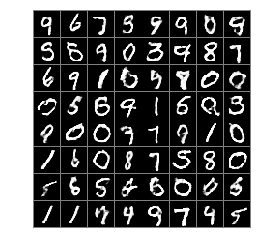

13900 0.5758834 1.6301973 0.88561594 0.26615077
not training discriminator


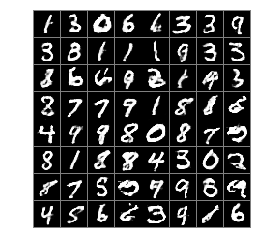

13950 0.64852613 1.638437 1.0307062 0.26634598
not training discriminator


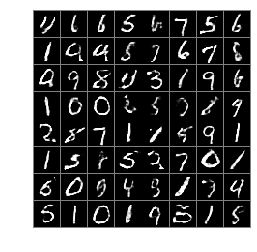

14000 0.5661781 1.3240501 0.78965676 0.34269953
not training discriminator


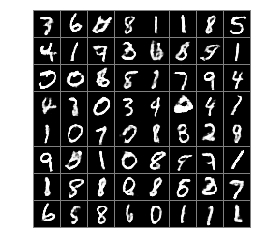

14050 0.6327281 1.3839217 0.9311594 0.3342968
not training discriminator


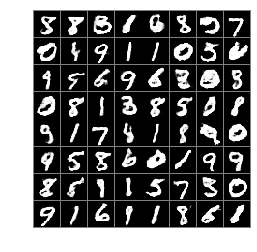

14100 0.56477785 1.175102 0.7268418 0.4027139
not training discriminator


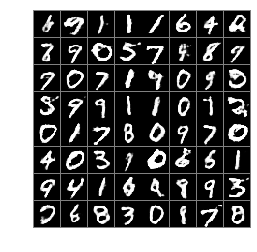

14150 0.6681481 1.648087 1.0890486 0.24724749
not training discriminator


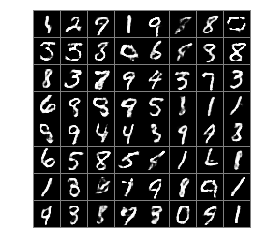

14200 0.6728121 1.3653297 0.9854566 0.36016765
not training discriminator


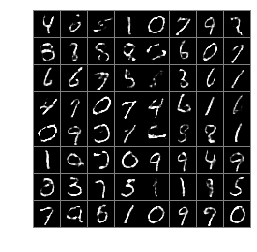

14250 0.5941108 1.2611628 0.8151869 0.37303466
not training discriminator


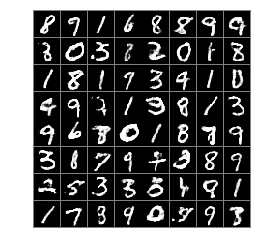

14300 0.66979074 1.4304687 1.0402889 0.29929256
not training discriminator


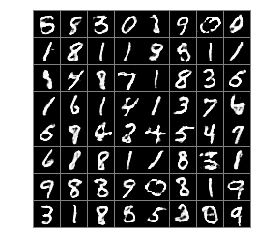

14350 0.58942026 1.1552324 0.7259326 0.45290783


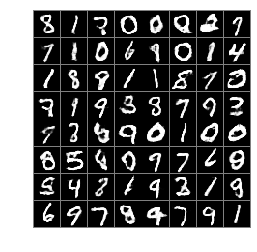

14400 0.64314824 1.3086705 0.9346073 0.3516892
not training discriminator


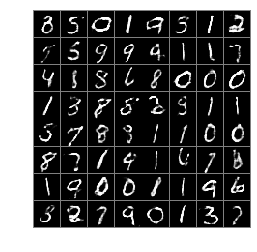

14450 0.70723367 1.3116697 1.0167329 0.39773428


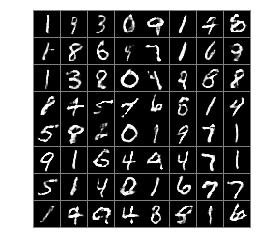

14500 0.61435807 1.3434756 0.8859819 0.3427342
not training discriminator


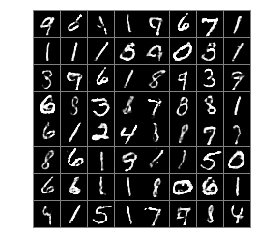

14550 0.65653664 1.3634157 0.9537282 0.35934508
not training discriminator


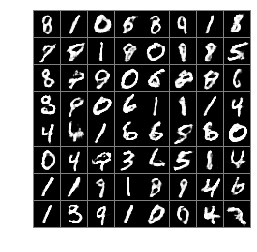

14600 0.5775225 1.0498431 0.6753958 0.47964928


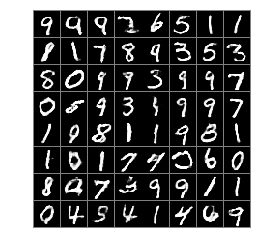

14650 0.635525 1.5466039 1.0003138 0.27073613
not training discriminator


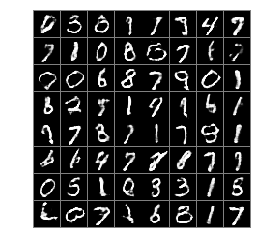

14700 0.5624167 1.4181151 0.78661203 0.33822128
not training discriminator


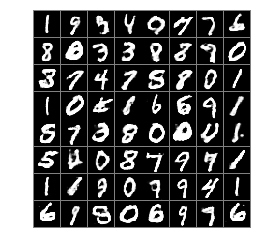

14750 0.5938093 1.243314 0.77184284 0.4157758
not training discriminator


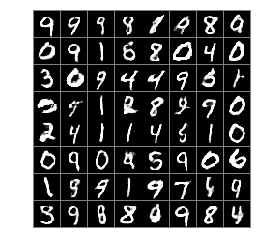

14800 0.5267025 1.3082138 0.7101585 0.34324658
not training discriminator


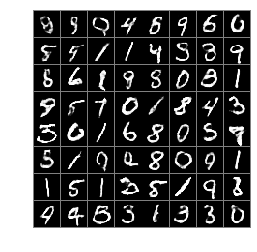

14850 0.5299965 1.2035306 0.65337425 0.40661886
not training discriminator


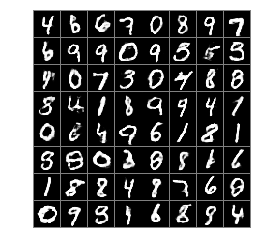

14900 0.54950523 0.9073794 0.49808148 0.60092914


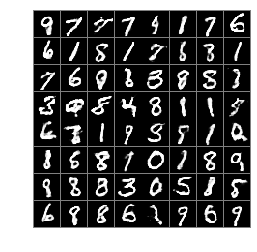

14950 0.5637396 1.0837553 0.6351752 0.49230385


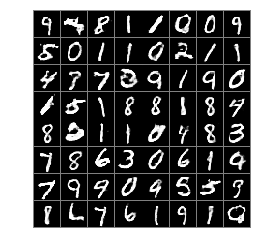

15000 0.67748964 0.55130297 0.31614122 1.0388381


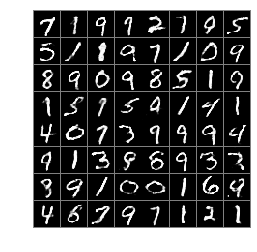

15050 0.6255005 0.745741 0.49576908 0.7552319


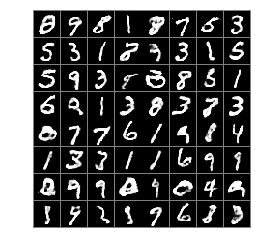

15100 0.5755083 1.3524964 0.81985563 0.3311609
not training discriminator


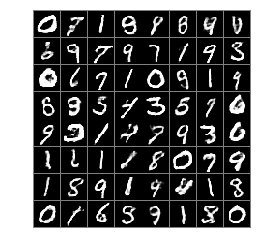

15150 0.5262139 1.1160548 0.6072101 0.4452177
not training discriminator


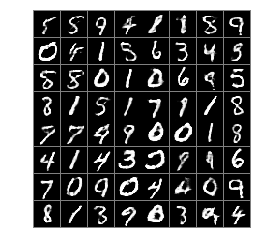

15200 0.64779603 1.592063 1.032634 0.26295817
not training discriminator


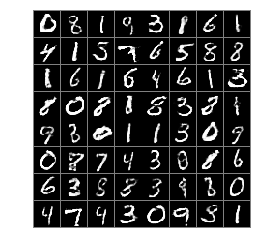

15250 0.56242406 0.74670887 0.383072 0.74177605


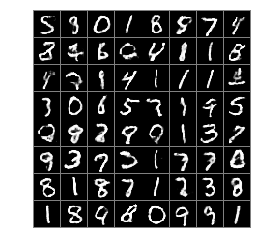

15300 0.62501454 1.5384482 0.96255046 0.28747877
not training discriminator


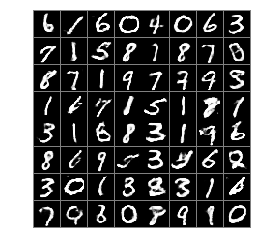

15350 0.620412 1.1964676 0.823802 0.417022


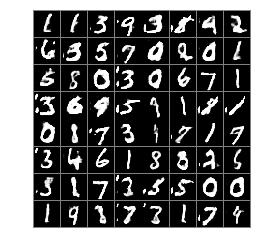

15400 0.5695877 1.1657629 0.72501266 0.4141627
not training discriminator


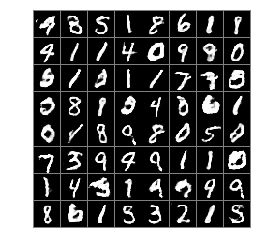

15450 0.5451366 1.0864956 0.64090705 0.4493661


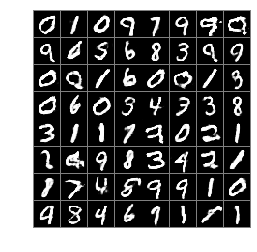

15500 0.49036032 1.0385656 0.49972263 0.48099798
not training discriminator


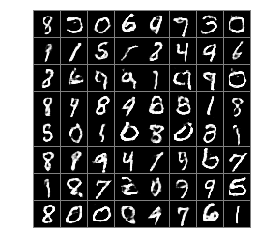

15550 0.51357424 1.3665117 0.70052725 0.3266212
not training discriminator


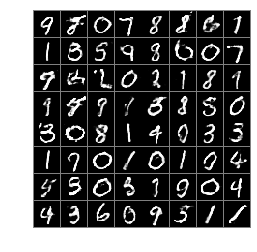

15600 0.5546539 1.296185 0.7548723 0.35443544
not training discriminator


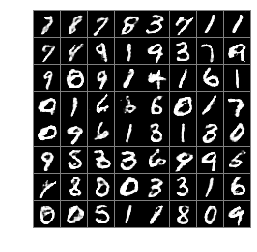

15650 0.5317321 1.3833747 0.73510945 0.32835472
not training discriminator


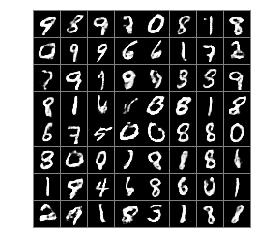

15700 0.61818343 1.6003618 0.9786835 0.25768346
not training discriminator


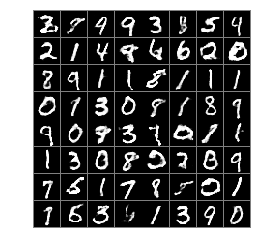

15750 0.6157031 1.4421424 0.9178703 0.31353587
not training discriminator


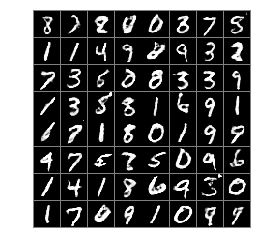

15800 0.56235886 1.575083 0.84909165 0.27562594
not training discriminator


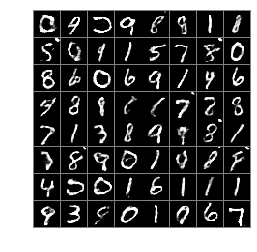

15850 0.6137804 1.3559207 0.8756855 0.3518752
not training discriminator


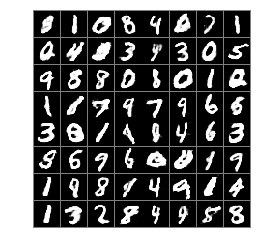

15900 0.5895806 1.2639097 0.79720896 0.38195217
not training discriminator


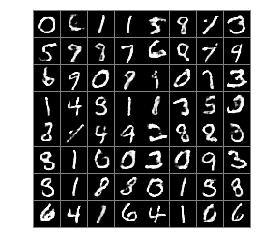

15950 0.6545613 1.317481 0.9408069 0.36831558
not training discriminator


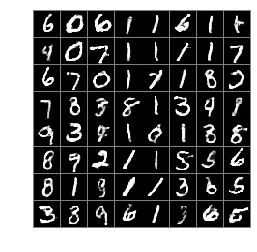

16000 0.52170956 1.1331758 0.613909 0.42951015
not training discriminator


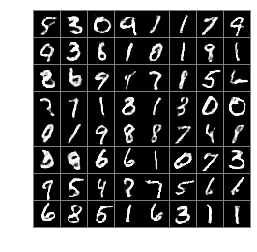

16050 0.66923654 1.3578354 0.9924827 0.34599054
not training discriminator


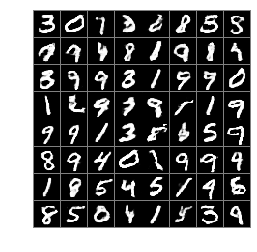

16100 0.5609785 1.2761552 0.7383696 0.38358742
not training discriminator


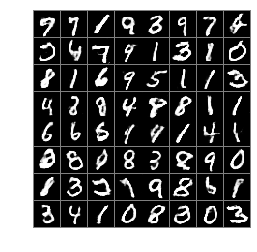

16150 0.5182135 1.1358492 0.5919068 0.44452024
not training discriminator


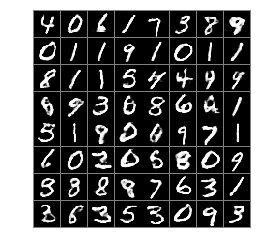

16200 0.61768436 1.2426771 0.8706392 0.36472952
not training discriminator


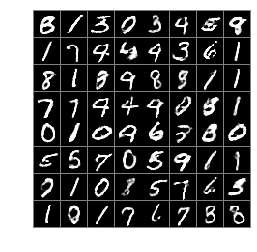

16250 0.54657406 1.2594988 0.7092985 0.38384965
not training discriminator


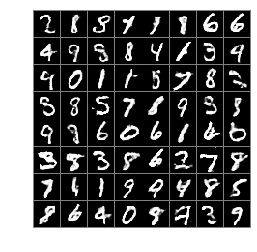

16300 0.5741459 1.2896619 0.7932925 0.35499933
not training discriminator


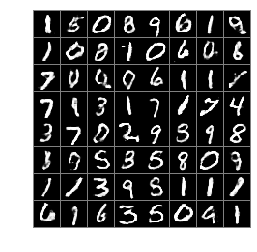

16350 0.53278434 1.0337871 0.5649123 0.5006565


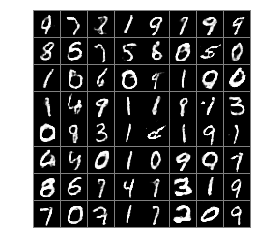

16400 0.5590829 1.0113919 0.62616 0.49200577


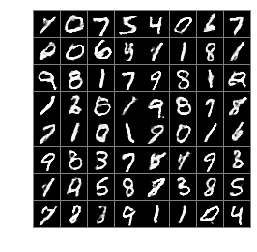

16450 0.59016263 1.2871569 0.79510754 0.38521773
not training discriminator


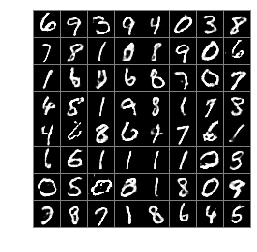

16500 0.5736626 1.0488013 0.66188884 0.48543632


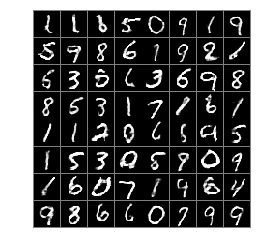

16550 0.5819732 1.0932256 0.68550456 0.47844177


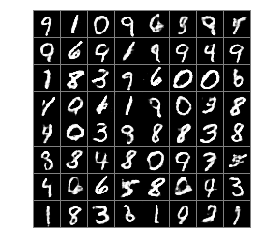

16600 0.58974314 1.3445877 0.83696294 0.34252337
not training discriminator


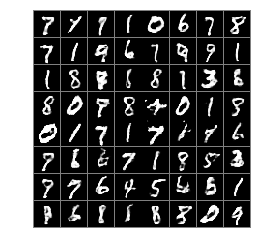

16650 0.55676806 1.1566529 0.6910852 0.42245087
not training discriminator


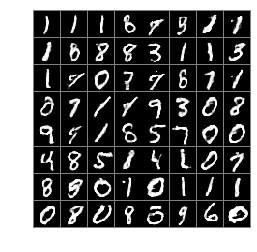

16700 0.5638884 0.8487263 0.49086085 0.636916


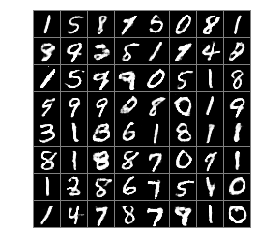

16750 0.6263797 1.6089433 0.9792185 0.27354097
not training discriminator


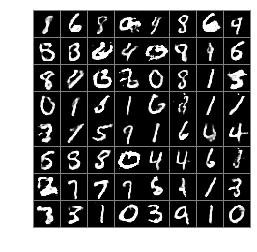

16800 0.57339865 1.1594296 0.72548366 0.42131358
not training discriminator


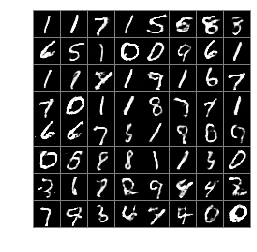

16850 0.550715 1.1972313 0.7041111 0.39731896
not training discriminator


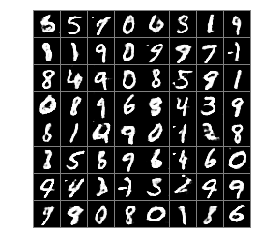

16900 0.6173362 0.7687724 0.4754013 0.7592711


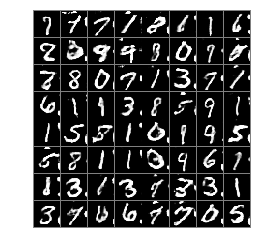

16950 0.6556146 1.5008407 1.023935 0.28729415
not training discriminator


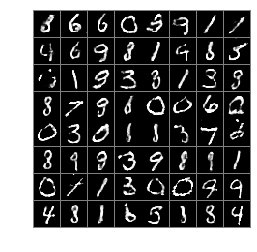

17000 0.63047695 1.3737321 0.92540157 0.3355523
not training discriminator


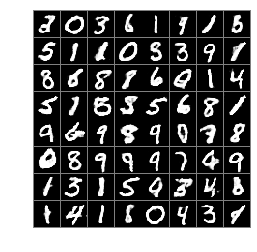

17050 0.5569692 1.2480693 0.68868446 0.42525414
not training discriminator


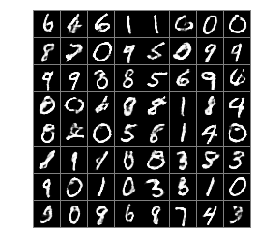

17100 0.6259091 1.2918699 0.88118416 0.37063414
not training discriminator


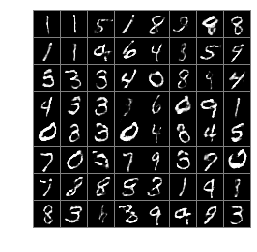

17150 0.49985063 1.3565377 0.6494266 0.35027465
not training discriminator


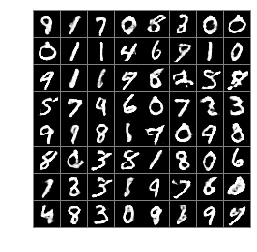

17200 0.5764078 1.5285743 0.8723169 0.28049874
not training discriminator


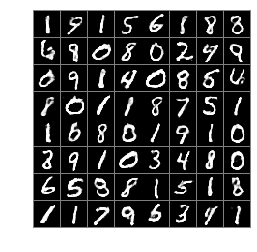

17250 0.57798934 1.3732243 0.828661 0.3273176
not training discriminator


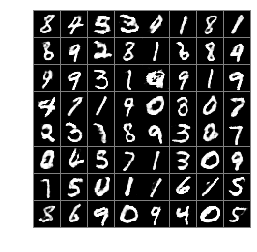

17300 0.54418164 1.3845232 0.7639344 0.32442886
not training discriminator


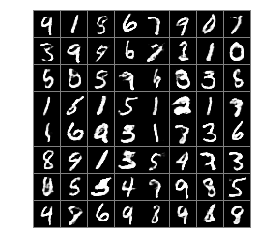

17350 0.54973996 1.2758039 0.7164638 0.3830161
not training discriminator


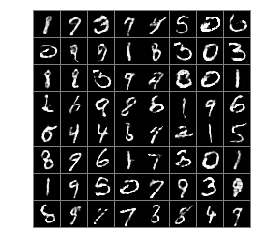

17400 0.53182626 1.3738368 0.72674465 0.33690792
not training discriminator


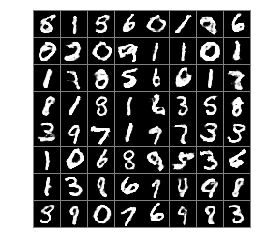

17450 0.5598117 1.5867896 0.8603382 0.2592852
not training discriminator


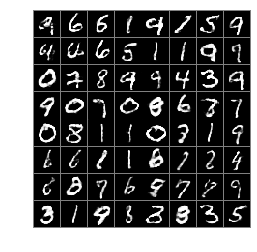

17500 0.6171485 0.6526539 0.36959475 0.86470234


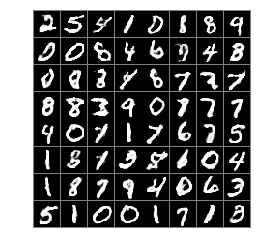

17550 0.65587753 1.3456469 0.95807165 0.35368347
not training discriminator


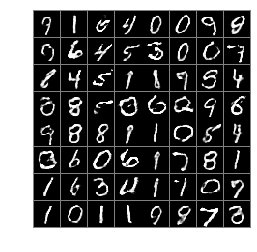

17600 0.57168484 1.249028 0.74633133 0.39703828
not training discriminator


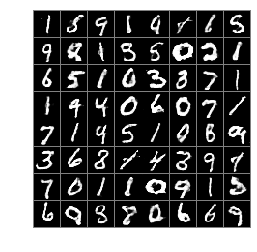

17650 0.5882179 1.434326 0.8666907 0.3097452
not training discriminator


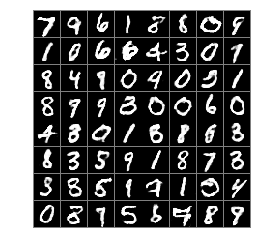

17700 0.643895 1.0098034 0.70996374 0.57782626


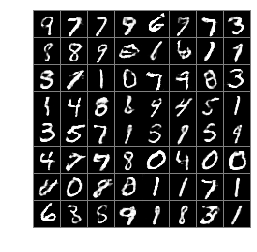

17750 0.5602586 1.3864987 0.76685727 0.35366
not training discriminator


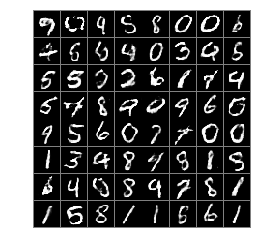

17800 0.6409886 1.523212 1.0152829 0.26669425
not training discriminator


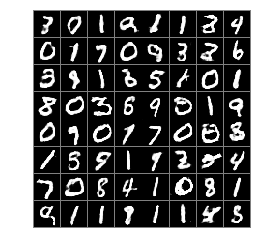

17850 0.5037929 1.2193451 0.6096846 0.39790115
not training discriminator


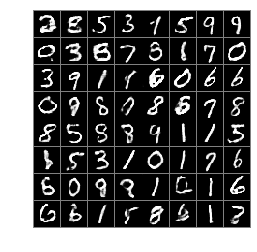

17900 0.56979483 1.3057963 0.7775941 0.3619956
not training discriminator


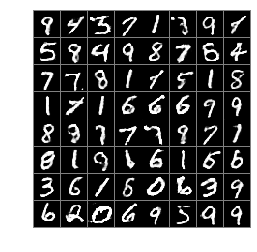

17950 0.53662336 1.2560544 0.7040512 0.36919552
not training discriminator


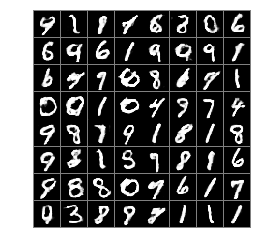

18000 0.6784797 1.5341182 1.0389014 0.3180579
not training discriminator


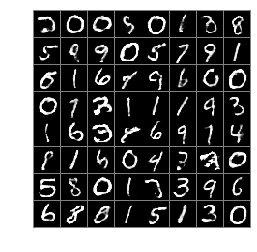

18050 0.5827246 1.5167047 0.89369243 0.27175683
not training discriminator


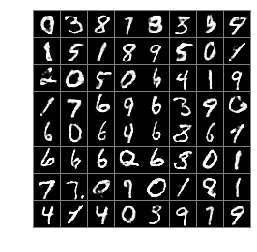

18100 0.57187766 0.9420088 0.5765513 0.567204


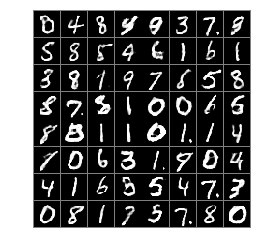

18150 0.5655937 1.2307942 0.73586965 0.39531788
not training discriminator


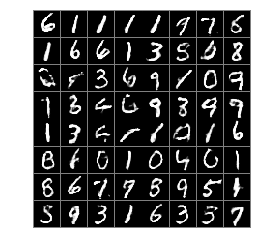

18200 0.5675623 1.3147202 0.78928196 0.3458426
not training discriminator


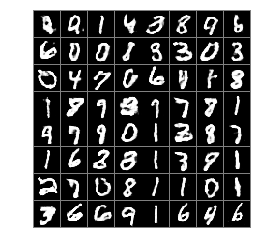

18250 0.7538419 1.8355999 1.3099177 0.19776607
not training discriminator


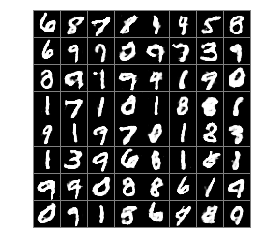

18300 0.49130014 0.87072825 0.33451623 0.648084


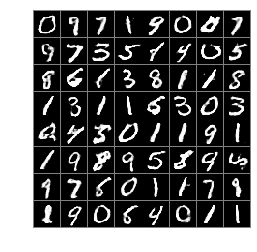

18350 0.612057 1.1677656 0.7941973 0.42991662


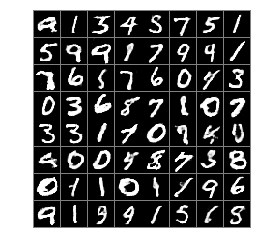

18400 0.6326427 1.5437199 0.9969646 0.26832068
not training discriminator


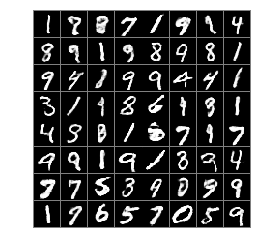

18450 0.5629765 1.5906919 0.86666024 0.25929272
not training discriminator


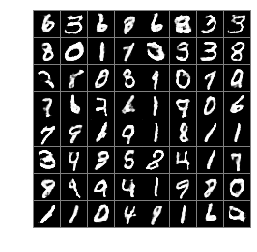

18500 0.59529907 1.1705052 0.7782692 0.41232896


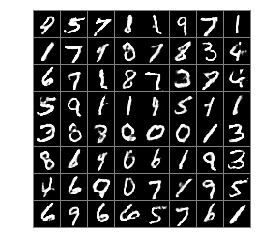

18550 0.54051995 1.4209039 0.7582069 0.32283297
not training discriminator


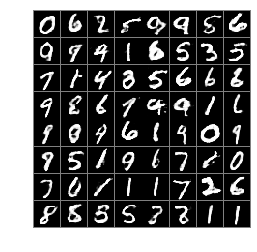

18600 0.6583673 1.2484336 0.9438503 0.37288418


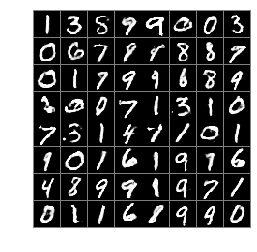

18650 0.61282814 1.3590764 0.89821506 0.32744116
not training discriminator


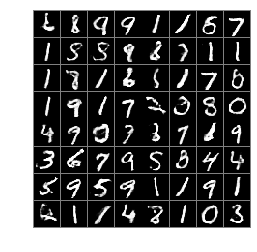

18700 0.6464071 1.4087908 0.95792323 0.33489102
not training discriminator


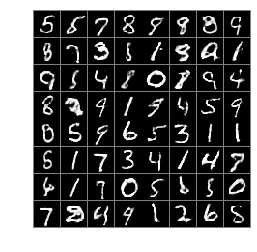

18750 0.5434606 1.5808423 0.8142706 0.2726506
not training discriminator


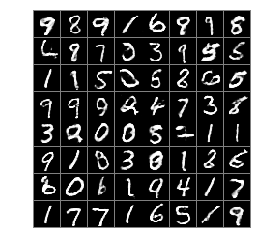

18800 0.55501384 1.0119908 0.60771406 0.5023137


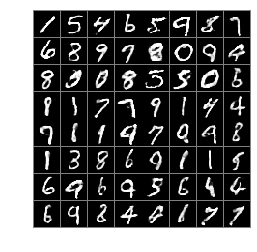

18850 0.56492734 0.9761122 0.57534134 0.5545133


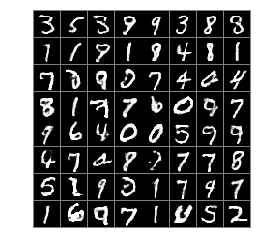

18900 0.64437294 1.4101884 0.94970715 0.33903864
not training discriminator


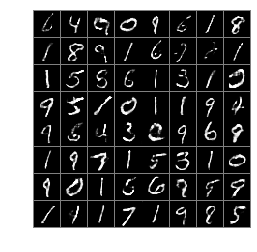

18950 0.6375483 1.4670006 0.9655341 0.30956262
not training discriminator


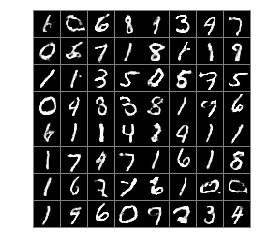

19000 0.5795671 1.2423368 0.7500185 0.40911573
not training discriminator


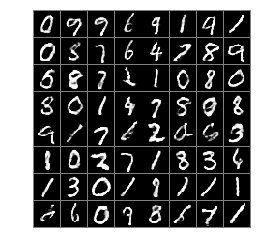

19050 0.55286366 1.3302431 0.7552116 0.35051572
not training discriminator


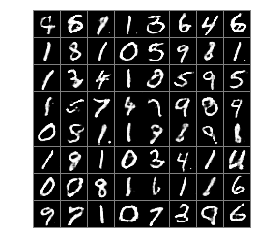

19100 0.54637766 1.3150085 0.70267767 0.39007777
not training discriminator


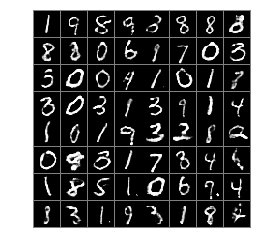

19150 0.51860815 0.8747247 0.44776705 0.5894492


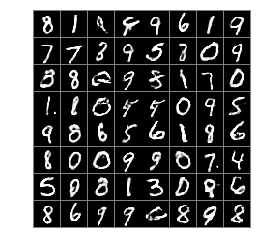

19200 0.60398257 1.3215871 0.85881364 0.34915155
not training discriminator


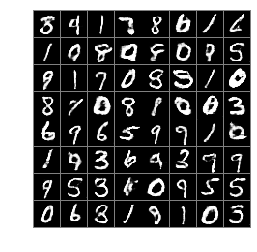

19250 0.5707916 1.316781 0.7876302 0.35395294
not training discriminator


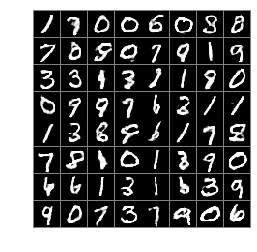

19300 0.59078777 1.4087193 0.86258984 0.31898576
not training discriminator


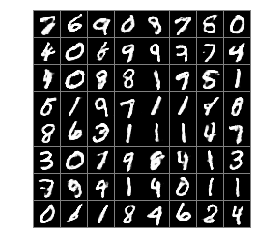

19350 0.560694 1.257857 0.7135967 0.40779126
not training discriminator


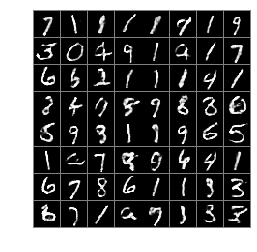

19400 0.5992025 1.3728228 0.850311 0.34809414
not training discriminator


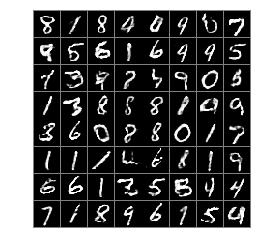

19450 0.5547609 1.36553 0.7823162 0.32720554
not training discriminator


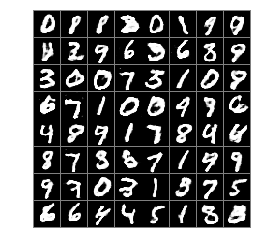

19500 0.5807644 0.88787544 0.56666946 0.5948593


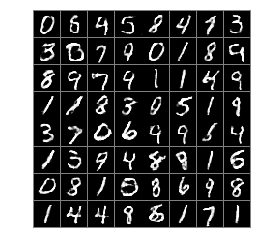

19550 0.66398835 1.2029603 0.8717967 0.45618007


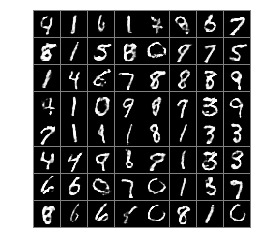

19600 0.6525721 1.5891771 1.0185035 0.2866407
not training discriminator


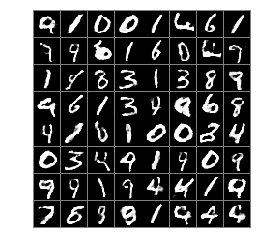

19650 0.6716461 1.641834 1.0854906 0.25780156
not training discriminator


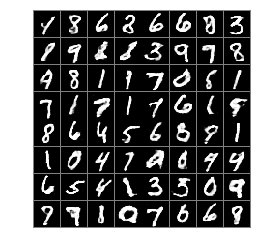

19700 0.5485726 1.2414904 0.6899392 0.40720597
not training discriminator


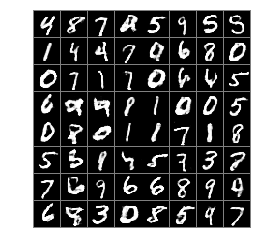

19750 0.509074 1.0080974 0.51148295 0.50666505


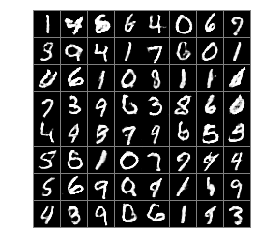

19800 0.5262122 1.0926359 0.6021234 0.45030117
not training discriminator


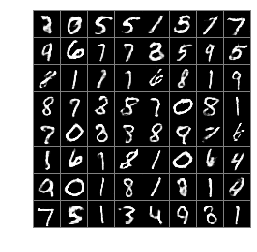

19850 0.5915518 1.297381 0.8116132 0.37149042
not training discriminator


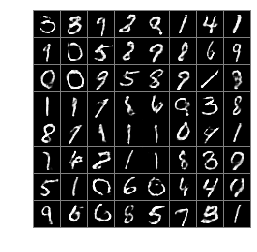

19900 0.60651714 1.2843289 0.7935757 0.41945845
not training discriminator


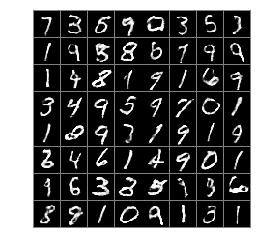

19950 0.62687254 1.50974 0.97579646 0.27794868
not training discriminator


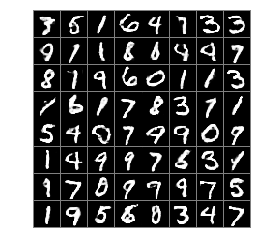

20000 0.5481167 0.89379716 0.49039614 0.6058372


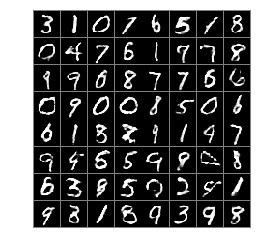

20050 0.54481363 0.7358445 0.36249065 0.72713673


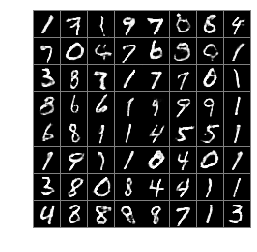

20100 0.5387826 1.5295651 0.8016948 0.27587038
not training discriminator


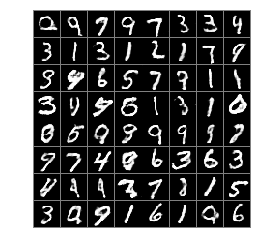

20150 0.53937227 1.0784775 0.6071219 0.47162262


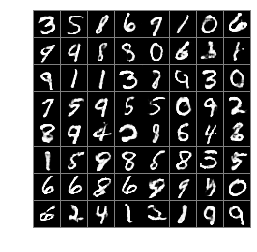

20200 0.53062236 1.1390057 0.6065208 0.4547241
not training discriminator


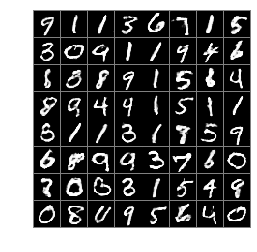

20250 0.5726238 0.7563033 0.41413563 0.7311119


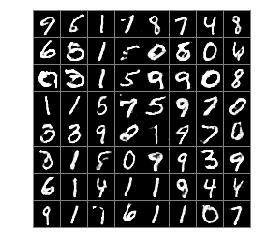

20300 0.51234555 1.1818278 0.60615075 0.41854036
not training discriminator


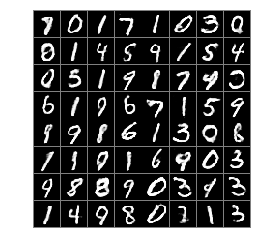

20350 0.65375024 1.3594992 0.9659304 0.34157005
not training discriminator


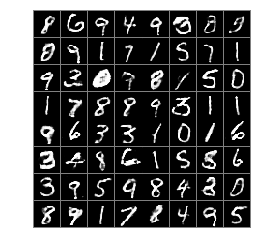

20400 0.5434853 1.2918823 0.7223447 0.3646258
not training discriminator


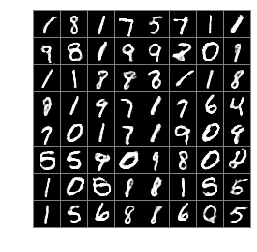

20450 0.49042818 1.1905451 0.57557195 0.4052844
not training discriminator


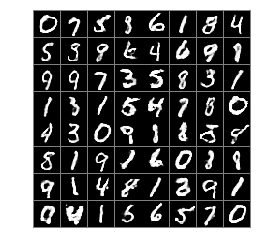

20500 0.5968258 1.5013018 0.9190329 0.2746187
not training discriminator


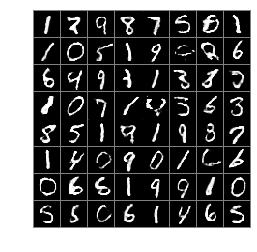

20550 0.52069443 1.1638048 0.62226343 0.41912544
not training discriminator


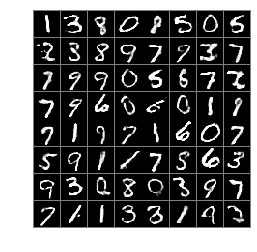

20600 0.63178754 1.3782932 0.9122138 0.35136124
not training discriminator


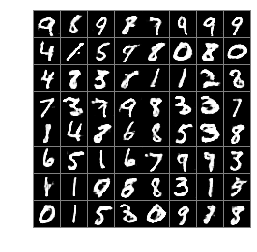

20650 0.50236595 1.2182605 0.59919417 0.40553778
not training discriminator


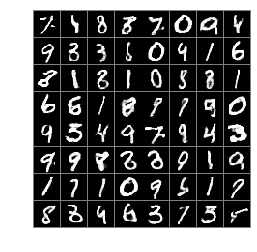

20700 0.5698735 1.3521774 0.7894373 0.35030982
not training discriminator


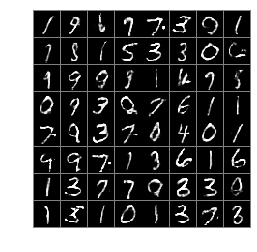

20750 0.57820535 1.0380427 0.65830296 0.49810776


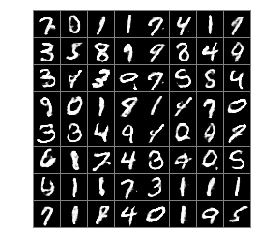

20800 0.55938435 1.3444872 0.7630919 0.3556766
not training discriminator


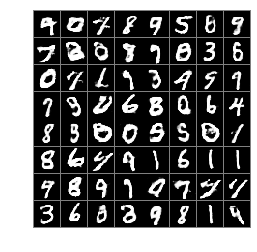

20850 0.54635596 1.2659798 0.71668684 0.37602514
not training discriminator


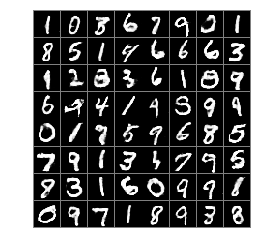

20900 0.6068936 1.4516106 0.89765054 0.3161366
not training discriminator


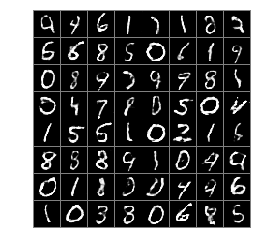

20950 0.5389154 1.503303 0.7743192 0.30351168
not training discriminator


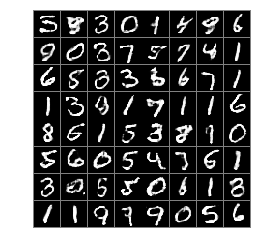

21000 0.65768254 1.3752968 0.96769035 0.3476746
not training discriminator


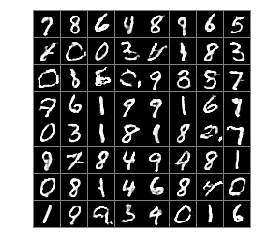

21050 0.56379867 1.4659768 0.82851416 0.29908323
not training discriminator


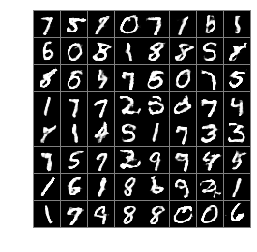

21100 0.51687884 1.3494642 0.64510775 0.3886499
not training discriminator


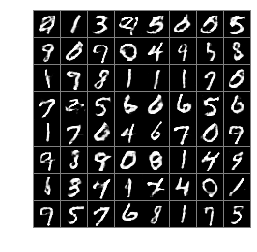

21150 0.63841623 1.5646294 0.9800464 0.29678604
not training discriminator


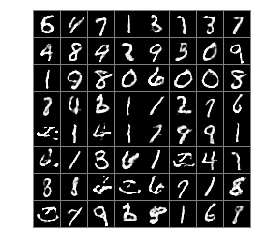

21200 0.59606487 1.3065934 0.8184285 0.3737013
not training discriminator


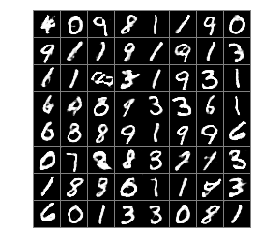

21250 0.63285446 1.3159893 0.93002856 0.33568037
not training discriminator


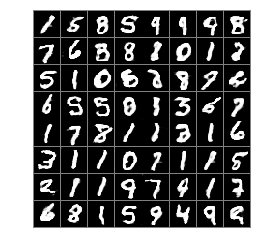

21300 0.64732337 1.6478498 1.0456215 0.24902514
not training discriminator


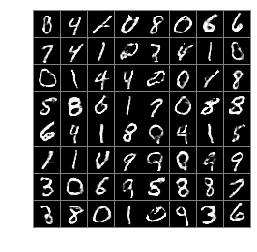

21350 0.5359383 1.2941403 0.6959885 0.37588817
not training discriminator


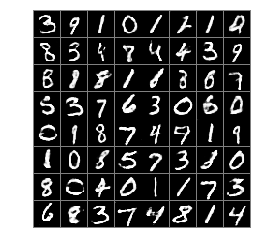

21400 0.5932489 1.1421599 0.75497615 0.4315216


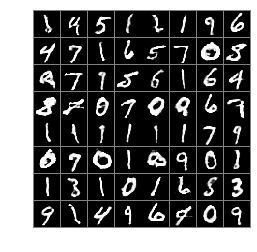

21450 0.5288259 1.2878983 0.65473235 0.40291953
not training discriminator


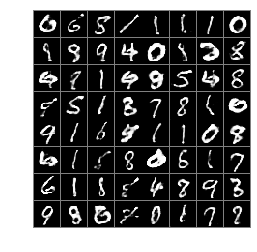

21500 0.5772979 1.4824891 0.8587238 0.29587194
not training discriminator


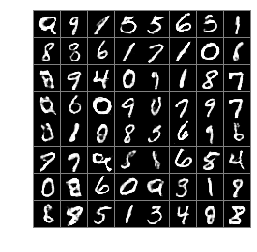

21550 0.541312 0.7446789 0.37587678 0.7067473


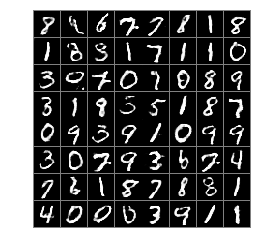

21600 0.49952686 0.9408603 0.45089096 0.5481628


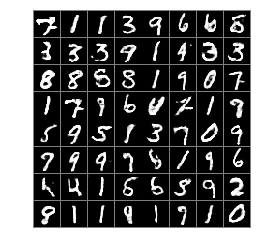

21650 0.5877378 1.6175193 0.91716355 0.25831205
not training discriminator


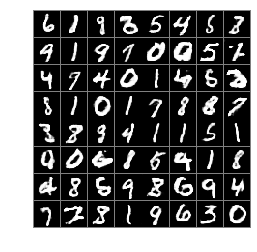

21700 0.5741981 1.4157324 0.8247498 0.3236465
not training discriminator


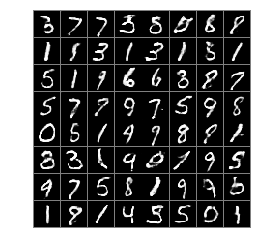

21750 0.6014949 0.62586045 0.32862514 0.8743646


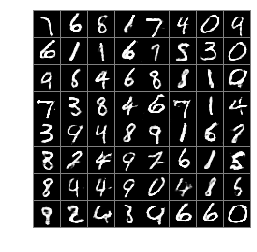

21800 0.58386177 1.573842 0.9096066 0.2581169
not training discriminator


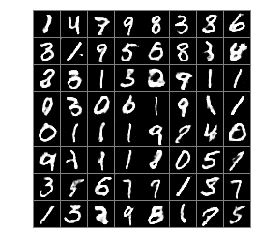

21850 0.6228769 1.4243422 0.93636936 0.30938452
not training discriminator


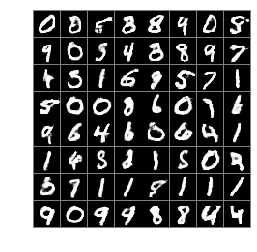

21900 0.56302303 1.4058304 0.81549424 0.31055173
not training discriminator


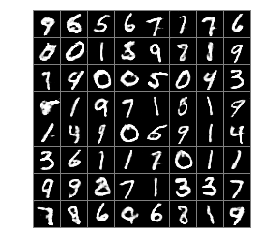

21950 0.6655199 1.775356 1.0970283 0.23401152
not training discriminator


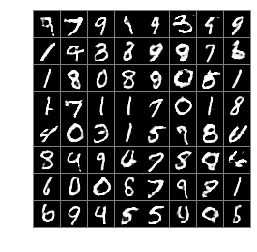

22000 0.5896448 1.359688 0.8518799 0.3274097
not training discriminator


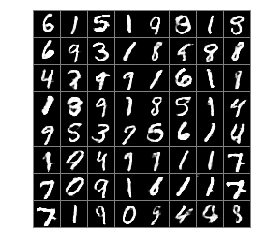

22050 0.5939176 1.3009694 0.84459513 0.34324008
not training discriminator


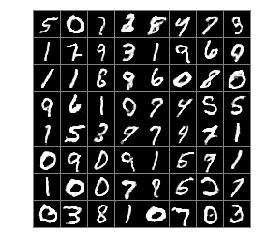

22100 0.5252789 1.2455041 0.6770222 0.37353557
not training discriminator


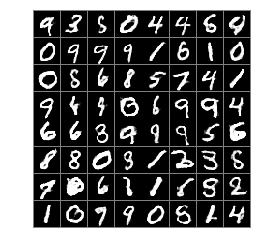

22150 0.68420506 1.3712437 1.0369997 0.33141047
not training discriminator


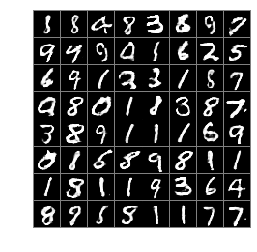

22200 0.65423465 1.5055633 1.0330521 0.27541727
not training discriminator


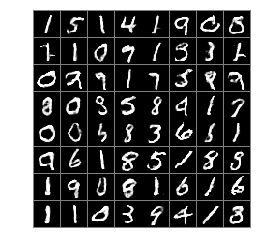

22250 0.5310225 1.694086 0.820527 0.2415179
not training discriminator


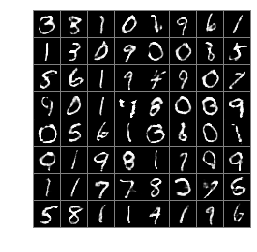

22300 0.55228513 1.2244877 0.71647716 0.38809305
not training discriminator


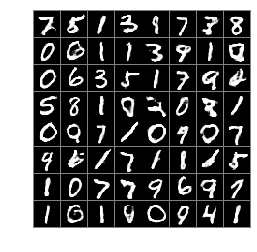

22350 0.5759628 1.1856763 0.7375884 0.4143372
not training discriminator


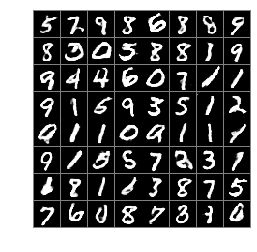

22400 0.5284182 1.2964205 0.7082964 0.34854007
not training discriminator


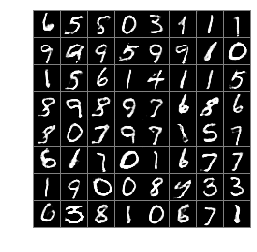

22450 0.65718436 1.3099829 0.9765183 0.33785045


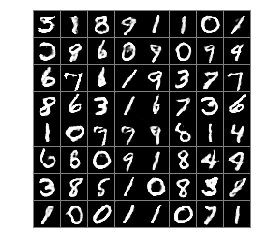

22500 0.6002046 1.4602597 0.8997767 0.30063248
not training discriminator


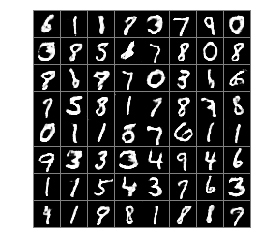

22550 0.5342703 1.4185265 0.7596092 0.3089314
not training discriminator


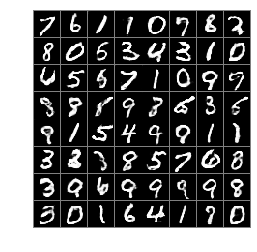

22600 0.5147097 1.245443 0.6618022 0.36761713
not training discriminator


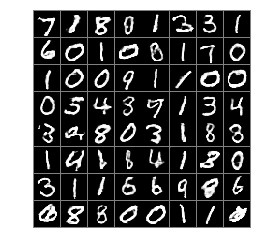

22650 0.59571254 1.2369337 0.7860563 0.40536866
not training discriminator


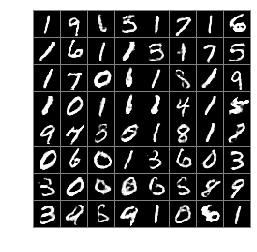

22700 0.5445167 1.2890518 0.72942036 0.359613
not training discriminator


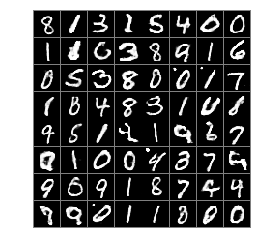

22750 0.5615665 1.2236996 0.7292508 0.39388222
not training discriminator


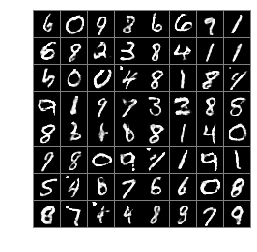

22800 0.55157876 1.3385808 0.7293971 0.3737604
not training discriminator


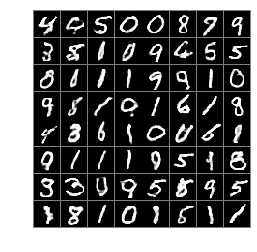

22850 0.59258544 1.6180019 0.94319886 0.24197191
not training discriminator


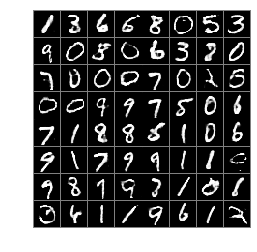

22900 0.5564776 1.29326 0.7605713 0.3523839
not training discriminator


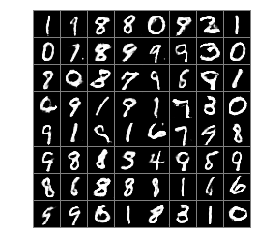

22950 0.5581069 1.1465743 0.6715807 0.44463307
not training discriminator


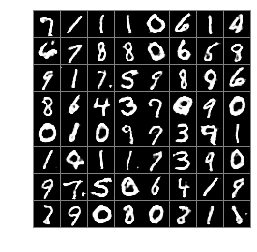

23000 0.5010052 0.99458945 0.44565317 0.55635715


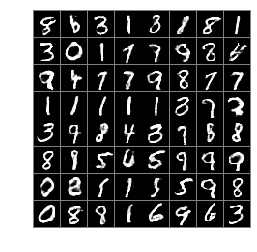

23050 0.5213493 1.3933802 0.7169167 0.32578182
not training discriminator


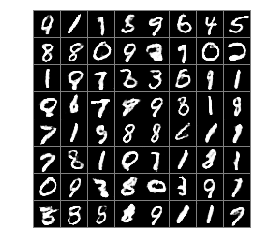

23100 0.5141696 1.4669998 0.73178387 0.29655522
not training discriminator


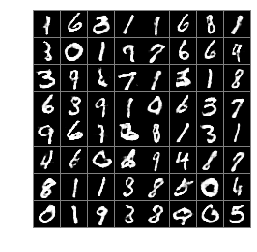

23150 0.51491135 1.399188 0.69886047 0.33096218
not training discriminator


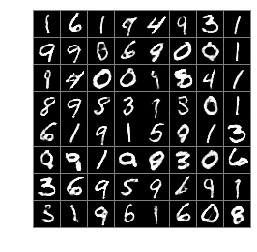

23200 0.5793613 1.304915 0.79926866 0.35945398
not training discriminator


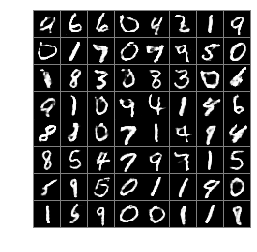

23250 0.58336 1.5447762 0.90093565 0.26578432
not training discriminator


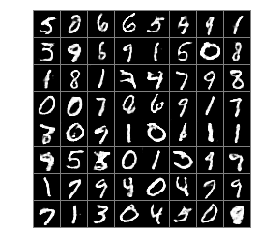

23300 0.4924718 1.2281059 0.61331165 0.37163195
not training discriminator


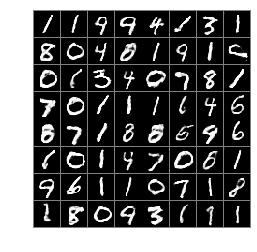

23350 0.6309899 0.63326436 0.33153337 0.9304464


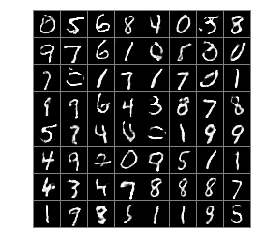

23400 0.5827833 1.2646046 0.78367513 0.38189152
not training discriminator


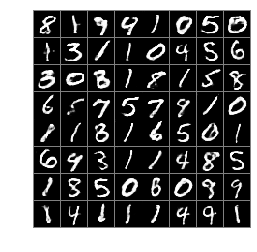

23450 0.58415926 1.3866711 0.85841084 0.30990762
not training discriminator


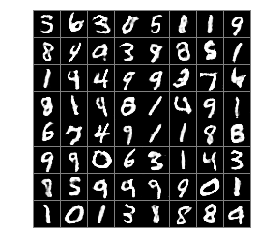

23500 0.507951 1.0088974 0.4884155 0.52748656


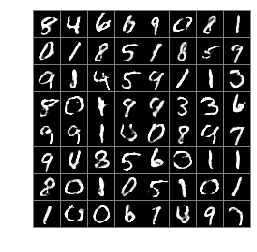

23550 0.5903909 0.6882434 0.39743245 0.78334945


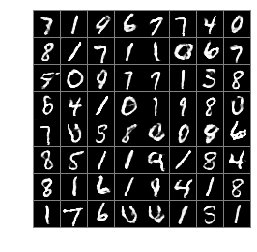

23600 0.52851295 1.2981473 0.6842506 0.3727754
not training discriminator


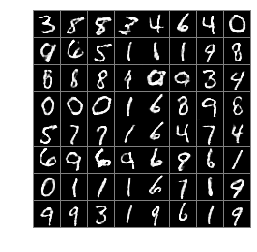

23650 0.6098069 0.8101584 0.5077866 0.7118273


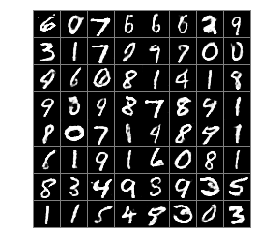

23700 0.5490198 1.1879501 0.64176214 0.4562775
not training discriminator


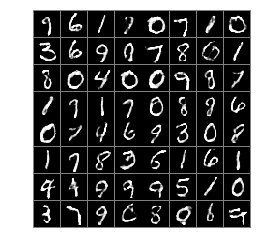

23750 0.53622264 0.9013561 0.45592913 0.6165162


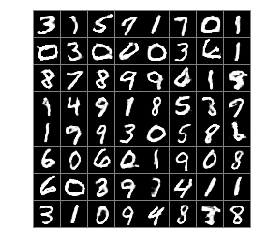

23800 0.60157955 1.4180521 0.87314224 0.3300169
not training discriminator


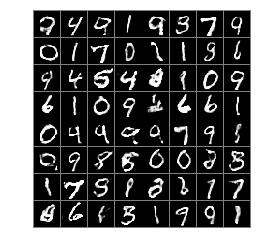

23850 0.6107892 1.4386048 0.8732327 0.34834555
not training discriminator


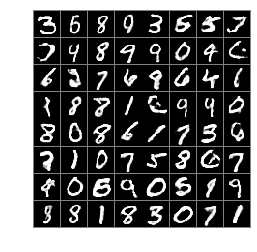

23900 0.5250679 1.148869 0.59971046 0.4504255
not training discriminator


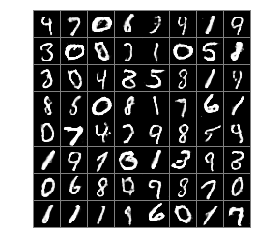

23950 0.6290766 1.5150355 0.9726356 0.2855176
not training discriminator


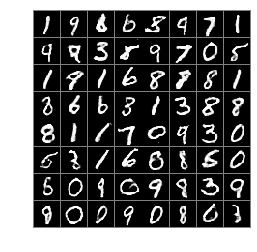

24000 0.5495484 1.302944 0.7471149 0.35198182
not training discriminator


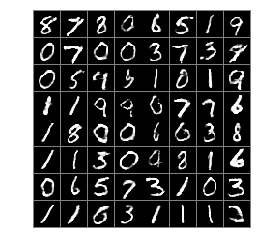

24050 0.56501544 1.3870066 0.7856463 0.3443846
not training discriminator


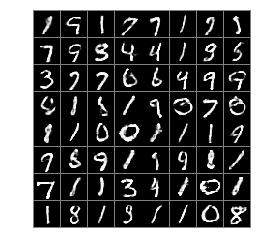

24100 0.5633403 1.4819505 0.8209137 0.305767
not training discriminator


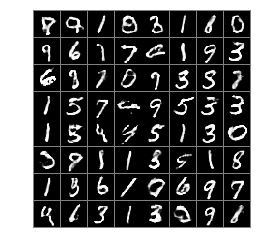

24150 0.6388154 1.2905765 0.8872025 0.39042836
not training discriminator


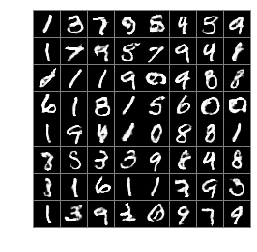

24200 0.5461274 1.1762011 0.6761181 0.41613668
not training discriminator


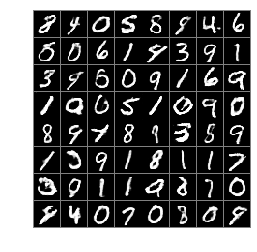

24250 0.49434203 1.133005 0.56103843 0.42764562
not training discriminator


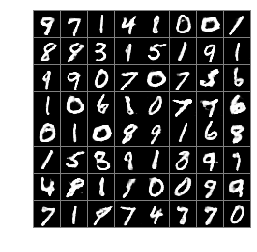

24300 0.5076809 1.3068962 0.66811347 0.34724838
not training discriminator


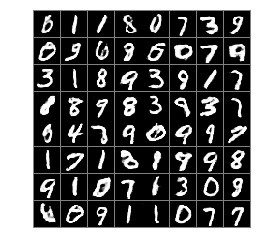

24350 0.6235715 1.0865109 0.78061056 0.46653247


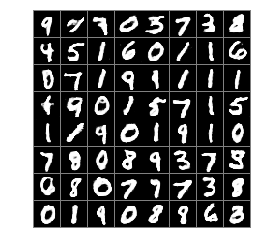

24400 0.56331927 1.3089135 0.78254473 0.34409392
not training discriminator


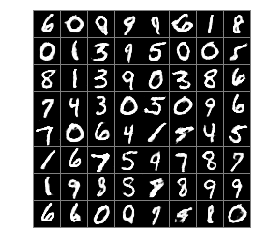

24450 0.5225512 1.3454447 0.7050979 0.34000435
not training discriminator


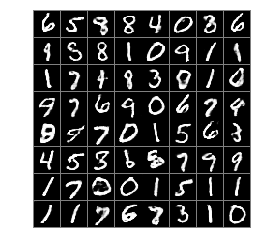

24500 0.5595174 1.2580247 0.7323313 0.3867036
not training discriminator


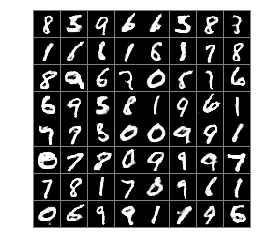

24550 0.58411664 1.3149182 0.8084948 0.3597385
not training discriminator


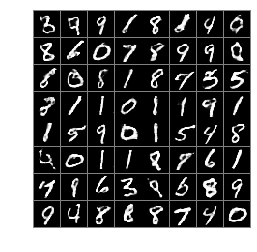

24600 0.6158504 1.5196759 0.94939846 0.28230238
not training discriminator


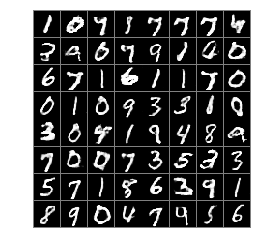

24650 0.57149017 1.42539 0.829741 0.3132392
not training discriminator


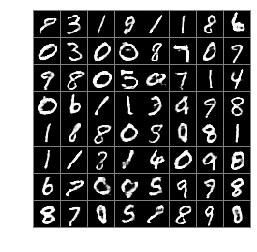

24700 0.52338207 1.3320626 0.68983066 0.35693344
not training discriminator


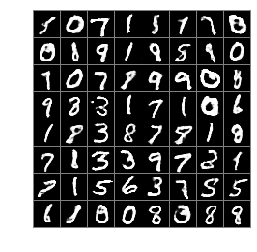

24750 0.5262031 1.3407353 0.70706946 0.34533674
not training discriminator


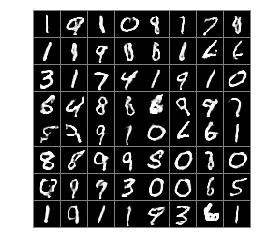

24800 0.5689604 1.3973207 0.8105074 0.32741344
not training discriminator


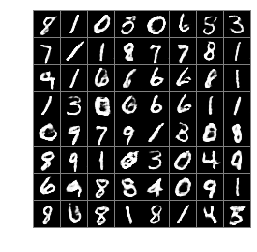

24850 0.55044633 1.2095468 0.7164885 0.38440412
not training discriminator


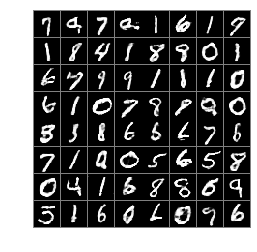

24900 0.52208865 0.92992365 0.46408468 0.5800926


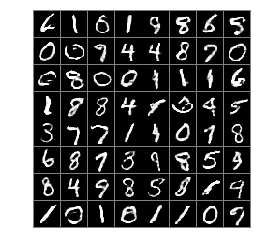

24950 0.46974605 1.0451888 0.46123123 0.47826087
not training discriminator


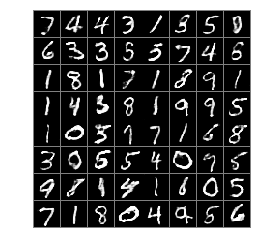

25000 0.5160699 1.1039729 0.58467185 0.44746786
not training discriminator


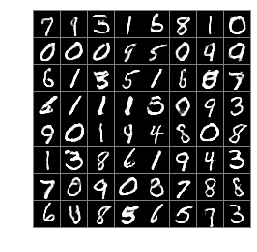

25050 0.49824467 1.2591441 0.61651254 0.37997684
not training discriminator


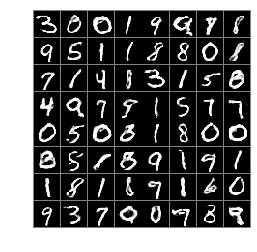

25100 0.6806021 1.5424376 1.1031468 0.2580573
not training discriminator


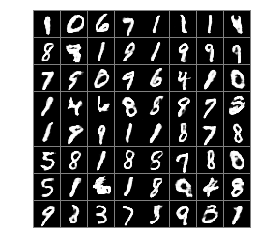

25150 0.48552996 1.1963742 0.5611508 0.40990907
not training discriminator


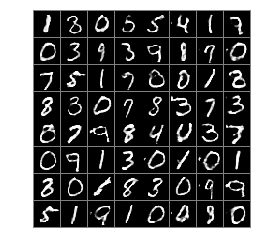

25200 0.48991233 1.092129 0.53525174 0.44457287
not training discriminator


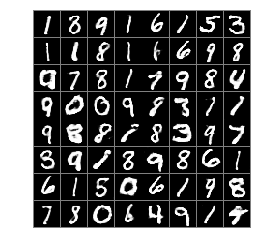

25250 0.59442484 1.5317069 0.877308 0.31154153
not training discriminator


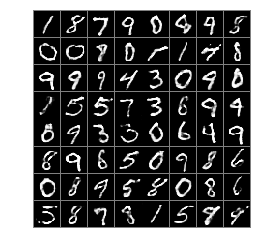

25300 0.6349807 1.4597309 0.9845191 0.28544238
not training discriminator


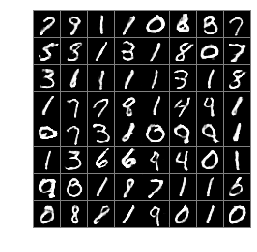

25350 0.5622222 1.4252627 0.8008387 0.32360557
not training discriminator


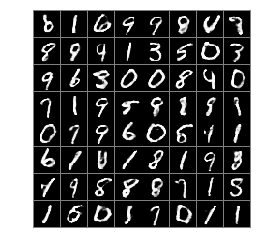

25400 0.5187302 1.4544413 0.7364903 0.30097014
not training discriminator


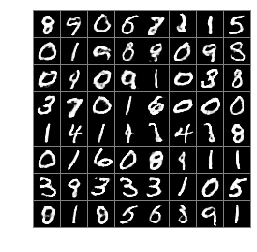

25450 0.6111903 1.6019202 0.9372529 0.2851277
not training discriminator


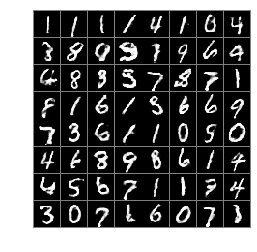

25500 0.5684383 0.76439655 0.42905498 0.7078216


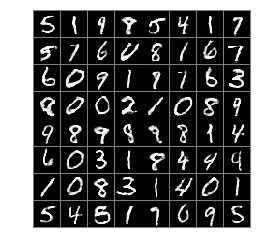

25550 0.5591859 1.6911639 0.8834464 0.23492548
not training discriminator


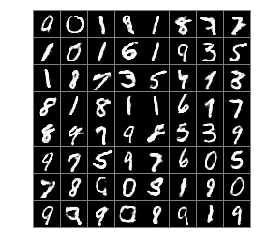

25600 0.5287904 1.164736 0.60098624 0.4565945
not training discriminator


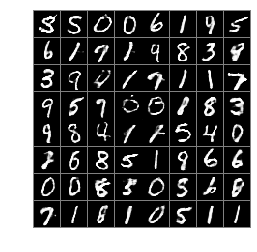

25650 0.52739054 1.4324422 0.76136315 0.2934178
not training discriminator


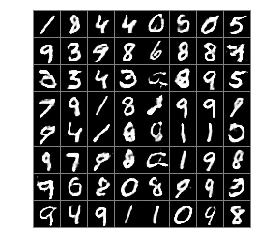

25700 0.5433873 0.721379 0.3070526 0.779722


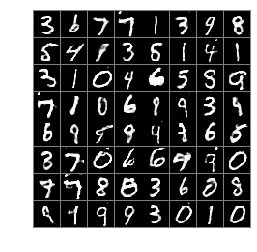

25750 0.5768888 1.2923279 0.7589724 0.3948052
not training discriminator


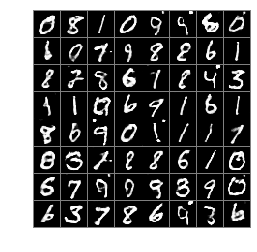

25800 0.61584675 1.4183111 0.9042443 0.32744914
not training discriminator


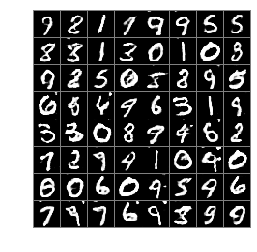

25850 0.48555636 1.3699316 0.6459929 0.3251199
not training discriminator


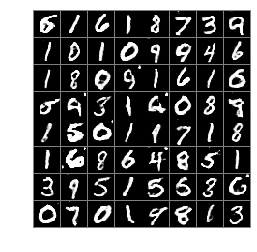

25900 0.54400903 1.0935993 0.61447495 0.47354317
not training discriminator


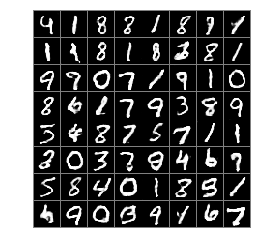

25950 0.496179 1.1829561 0.5789205 0.41343752
not training discriminator


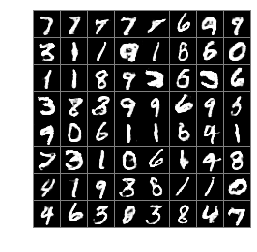

26000 0.64796454 1.5882746 1.0376232 0.2583059
not training discriminator


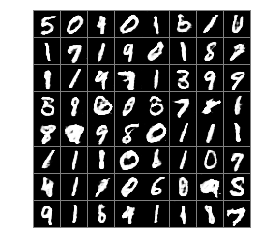

26050 0.49988678 1.322605 0.6389796 0.3607939
not training discriminator


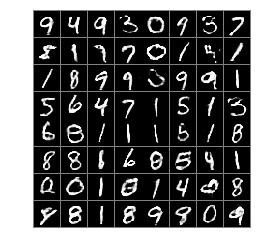

26100 0.49419132 1.3611741 0.6480746 0.34030804
not training discriminator


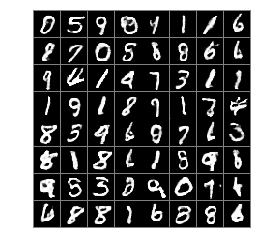

26150 0.5667749 1.4567256 0.821515 0.3120348
not training discriminator


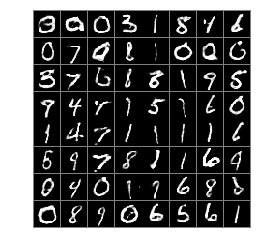

26200 0.52138317 1.1547256 0.5914074 0.45135897
not training discriminator


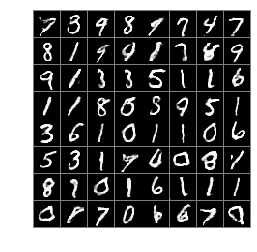

26250 0.59451115 1.6438979 0.9424738 0.2465485
not training discriminator


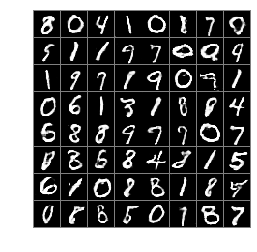

26300 0.5576942 1.4291177 0.79892755 0.3164608
not training discriminator


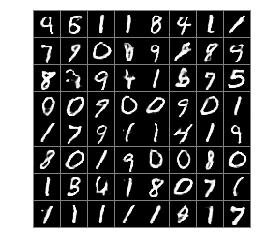

26350 0.62221324 1.0001649 0.72986335 0.51456314


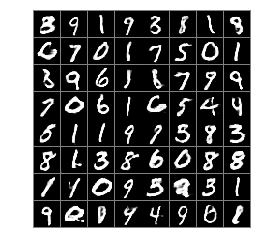

26400 0.52651674 1.3435996 0.71780294 0.33523056
not training discriminator


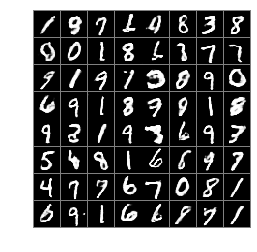

26450 0.59508437 1.7407919 0.9726488 0.21751988
not training discriminator


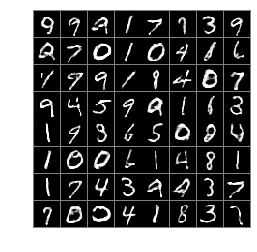

26500 0.575992 1.4167762 0.85196114 0.3000229
not training discriminator


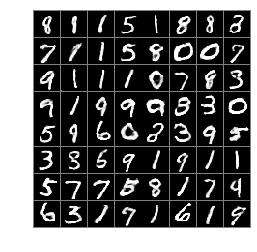

26550 0.6437493 1.2997555 0.9235009 0.3639977
not training discriminator


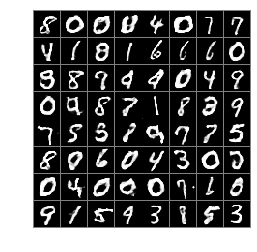

26600 0.61778814 1.6636484 1.0042804 0.23129585
not training discriminator


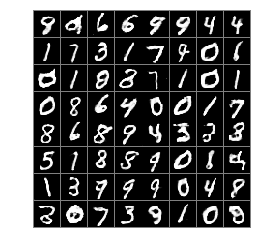

26650 0.5290561 1.4167327 0.7502346 0.30787754
not training discriminator


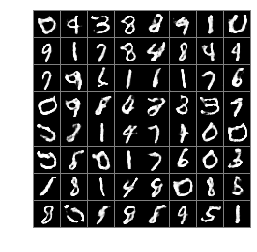

26700 0.4792308 1.0527337 0.47910005 0.47936153
not training discriminator


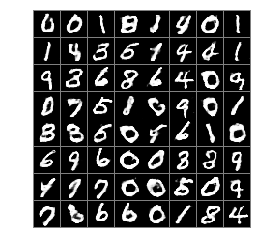

26750 0.75917846 1.442454 1.1173763 0.40098065


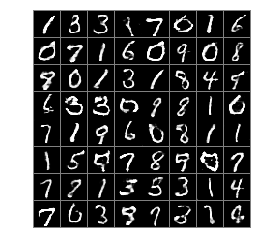

26800 0.5592277 1.2806106 0.7534882 0.3649671
not training discriminator


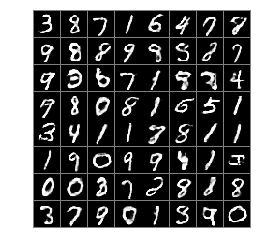

26850 0.56673396 0.90084326 0.5044534 0.62901455


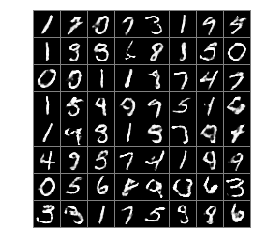

26900 0.61600935 1.2089967 0.8048669 0.4271518


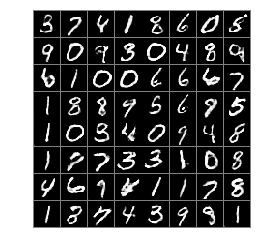

26950 0.4769554 1.5464367 0.6865073 0.26740348
not training discriminator


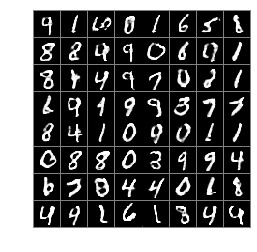

27000 0.58499074 1.4296715 0.861161 0.3088205
not training discriminator


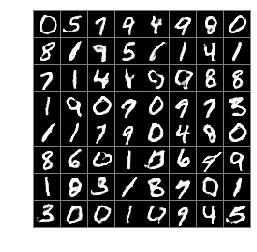

27050 0.57229245 1.1821597 0.74045503 0.40412992
not training discriminator


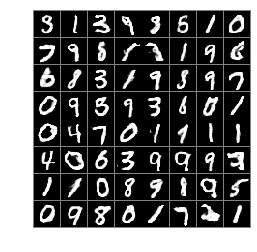

27100 0.5376061 1.3336709 0.71094054 0.36427182
not training discriminator


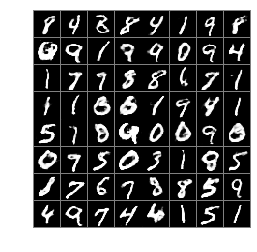

27150 0.539845 1.3581355 0.73304987 0.34664017
not training discriminator


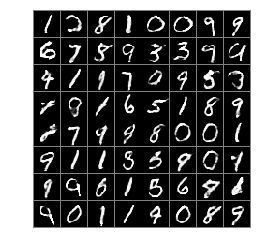

27200 0.49919385 1.09736 0.5424683 0.45591936
not training discriminator


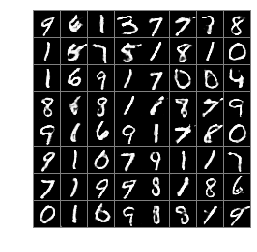

27250 0.58577585 1.3753235 0.8000207 0.37153107
not training discriminator


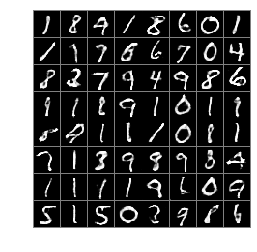

27300 0.5346235 1.2303426 0.67170244 0.39754462
not training discriminator


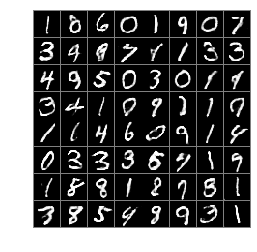

27350 0.58218265 1.3517476 0.803995 0.3603701
not training discriminator


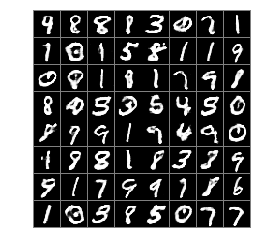

27400 0.50910676 0.90200543 0.4274857 0.5907278


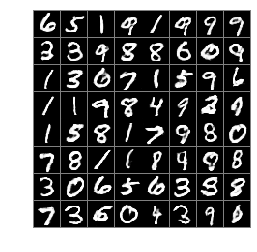

27450 0.5666612 1.3150702 0.7820389 0.35128337
not training discriminator


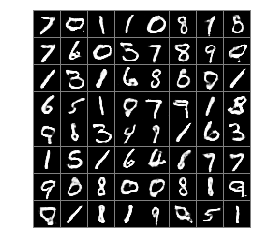

27500 0.59292716 1.0323417 0.6533912 0.5324631


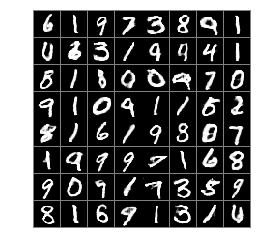

In [ ]:
for i in range(60000):
    train_d = True
    train_g = True
    keep_prob_train = 0.5
    
    
    n = np.random.uniform(0.0, 1.0, [batch_size, n_noise]).astype(np.float32)   
    batch = [np.reshape(b, [28, 28]) for b in mnist.train.next_batch(batch_size=batch_size)[0]]  
    
    d_real_ls, d_fake_ls, g_ls, d_ls = sess.run([loss_d_real, loss_d_fake, loss_g, loss_d], feed_dict={X_in: batch, noise: n, keep_prob: keep_prob_train, is_training:True})
    
    d_real_ls = np.mean(d_real_ls)
    d_fake_ls = np.mean(d_fake_ls)
    g_ls = g_ls
    d_ls = d_ls
    
    if g_ls * 1.5 < d_ls:
        train_g = False
        pass
    if d_ls * 2 < g_ls:
        train_d = False
        pass
    
    if train_d:
        sess.run(optimizer_d, feed_dict={noise: n, X_in: batch, keep_prob: keep_prob_train, is_training:True})
        
        
    if train_g:
        sess.run(optimizer_g, feed_dict={noise: n, keep_prob: keep_prob_train, is_training:True})
        
        
    if not i % 50:
        print (i, d_ls, g_ls, d_real_ls, d_fake_ls)
        if not train_g:
            print("not training generator")
        if not train_d:
            print("not training discriminator")
        gen_img = sess.run(g, feed_dict = {noise: n, keep_prob: 1.0, is_training:False})
        imgs = [img[:,:,0] for img in gen_img]
        m = montage(imgs)
        gen_img = m
        plt.axis('off')
        plt.imshow(gen_img, cmap='gray')
        plt.show()

In [10]:
tf.reset_default_graph() 